# The FINAL FINAL FINAL CODE

In [ ]:
import numpy as np
import os
import tensorflow as tf
import keras
import cv2
from math import ceil, sqrt, floor

import matplotlib.pyplot as plt
import matplotlib.patches as patches

from tqdm import tqdm
import random
from PIL import Image
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

from scipy.ndimage import center_of_mass, label as nd_label, find_objects
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score

from keras import regularizers, layers, models
from keras.callbacks import EarlyStopping, ReduceLROnPlateau

from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture
from hdbscan import HDBSCAN
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import pairwise_distances
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from scipy.ndimage import gaussian_filter, center_of_mass

from scipy.stats import skew
from scipy.spatial.distance import cdist

import seaborn as sns
from kneed import KneeLocator

import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage import measure

from ipywidgets import interact
import matplotlib.pyplot as plt
from scipy.stats import mode

from collections import Counter

print("TensorFlow version:", tf.__version__)

physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs Available:", physical_devices)

tile_size=32

TensorFlow version: 2.15.0
GPUs Available: []


## Extracting image files
Saved to a dataframe

In [2]:
data_dir = "MSc2024_Data/jpg"

# Lists to store extracted data
image_list = []
image_data_list = []
type_list = []
month_list = []
day_list = []

# Going through the dataset
for dataset_type in ['train', 'test', 'predict']:  # High-level folders
    type_path = os.path.join(data_dir, dataset_type)
    if not os.path.isdir(type_path):
        continue
    
    if dataset_type == 'predict':
        # Predict folder contains only image files
        for file in os.listdir(type_path):
            if file.endswith('.jpg') and not file.startswith('._'):
                image_path = os.path.join(type_path, file)
                with Image.open(image_path) as img:
                    image_array = np.array(img)[:,:,0]/255.0
                
                image_list.append(image_array)
                image_data_list.append("No data")  # No metadata available
                type_list.append('Predict')
                month_list.append('N/A')
                day_list.append('N/A')
    
    else:
        # For train and test folders with month/day substructure
        for month_folder in os.listdir(type_path):  
            month_path = os.path.join(type_path, month_folder)
            if not os.path.isdir(month_path):
                continue
            
            for day_folder in os.listdir(month_path):  
                day_path = os.path.join(month_path, day_folder)
                if not os.path.isdir(day_path):
                    continue
                
                for file in os.listdir(day_path):
                    if file.endswith('.jpg') and not file.startswith('._'):
                        image_path = os.path.join(day_path, file)
                        txt_path = os.path.splitext(image_path)[0] + ".txt"

                        with Image.open(image_path) as img:
                            image_array = np.array(img)[:,:,0]/255.0
                        
                        if os.path.exists(txt_path):
                            with open(txt_path, 'r') as f:
                                image_metadata = f.read().strip()
                        else:
                            image_metadata = "No data"

                        month = month_folder.split('_')[-1]
                        day = int(day_folder.split('_')[-1])

                        image_list.append(image_array)
                        image_data_list.append(image_metadata)
                        type_list.append(dataset_type.capitalize())
                        month_list.append(month)
                        day_list.append(day)


# Create the structured DataFrame
data = pd.DataFrame({
    'Image': image_list,
    'Image data': image_data_list,
    'Type': type_list,
    'Month': month_list,
    'Day': day_list
})

print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1774 entries, 0 to 1773
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Image       1774 non-null   object
 1   Image data  1774 non-null   object
 2   Type        1774 non-null   object
 3   Month       1774 non-null   object
 4   Day         1774 non-null   object
dtypes: object(5)
memory usage: 69.4+ KB
None


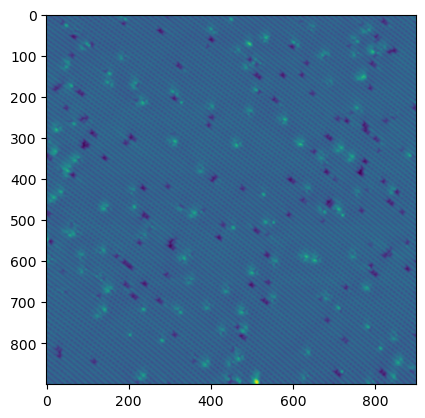

In [3]:
plt.imshow(data['Image'][data['Type']=='Predict'].iloc[2])

## Cropping and segmenting images for training
Save the generated arrays from the code below to disk to avoid having to run this again. Instead load it

### Code to crop and segment image

In [ ]:
def crop(image, pixels):
    """
    Crop an image to the closest multiple of pixel value for both width and height.

    :param image_path: Path to the input image.
    :param output_path: Path to save the cropped image.
    """
    # Open the image
    width, height = image.shape
    
    # Calculate the new dimensions (closest multiple less than or equal to the original size)
    new_width = (width // pixels) * pixels
    new_height = (height // pixels) * pixels
    
    # Calculate the cropping box (left, upper, right, lower)
    left = (width - new_width) // 2
    upper = (height - new_height) // 2
    right = left + new_width
    lower = upper + new_height
    
    # Crop the image
    cropped_img = image[left:right, upper:lower]
    
    # Save the cropped image
    return np.array(cropped_img)


def segmenter(img, tile_size):
    rows = int(img.shape[0]/tile_size)
    cols = int(img.shape[1]/tile_size)
    segments = []

    for i in range(0, img.shape[0], tile_size):
        for j in range(0, img.shape[1], tile_size):
            segment = img[i:i+tile_size, j:j+tile_size]
            segments.append(segment)
    return segments, rows, cols

tile_size = 32

cropped_train_images = []
cropped_test_images = []

for i in tqdm((data[data['Type'] == 'Train']['Image']), desc='Cropping training images'):
    img = crop(i , tile_size)
    cropped_train_images.append(img)
    
for i in tqdm((data[data['Type'] == 'Test']['Image']), desc='Cropping testing images'):
    img = crop(i , tile_size)
    cropped_test_images.append(img)


total_train_segments = sum((i.shape[0] // tile_size) * (i.shape[1] // tile_size) for i in cropped_train_images)
total_test_segments = sum((i.shape[0] // tile_size) * (i.shape[1] // tile_size) for i in cropped_test_images)

training = np.empty((total_train_segments, tile_size, tile_size))
testing = np.empty((total_test_segments, tile_size, tile_size))

ind = 0 
for i in tqdm(cropped_train_images, desc='Segmenting images'):
    segments = segmenter(i, tile_size)[0]
    for j in segments:
        training[ind] = np.array(j)
        ind+=1

ind = 0
for i in tqdm(cropped_test_images, desc='Segmenting images'):
    segments = segmenter(i, tile_size)[0]
    for j in segments:
        testing[ind] = np.array(j)
        ind+=1

# Shuffle
np.random.shuffle(training)
np.random.shuffle(testing)

print(training.shape, testing.shape)

### Load arrays instead

In [ ]:
training  = np.load('training.npy')
testing = np.load('testing.npy')

## Autoencoder 1 Setup

### Code to train autoencoder 1
Set up AE 1. Training and testing on arrays training and testing. I sent this off to a HPC cluster to train. It takes 48 hours even on the cluster.

If you do want to run the training locally, use a small slice of training and testing set with ~32 batchsize and ~15 epochs or even smaller.

Can load pretrained model from disk instead from cell underneath.

In [ ]:
latent_neurons = 32

# Autoencoder model
input_layer = keras.layers.Input(shape=(tile_size, tile_size, 1))

# Encoder layer 1
conv1 = keras.layers.Conv2D(
    128, 3, activation='relu', padding='same',
    kernel_regularizer=regularizers.l2(0.0001)
)(input_layer)
bn1 = keras.layers.BatchNormalization()(conv1)
act1 = keras.layers.Activation('relu')(bn1)
pool1 = keras.layers.MaxPooling2D(pool_size=2, padding='same')(act1)

# Encoder layer 2
conv2 = keras.layers.Conv2D(
    256, 3, activation='relu', padding='same',
    kernel_regularizer=regularizers.l2(0.0001)
)(pool1)
bn2 = keras.layers.BatchNormalization()(conv2)
act2 = keras.layers.Activation('relu')(bn2)
pool2 = keras.layers.MaxPooling2D(pool_size=2, padding='same')(act2)

# Layer 3
conv3 = keras.layers.Conv2D(
    512, 3, activation='relu', padding='same',
    kernel_regularizer=regularizers.l2(0.0001)
)(pool2)
bn3 = keras.layers.BatchNormalization()(conv3)
act3 = keras.layers.Activation('relu')(bn3)
pool3 = keras.layers.MaxPooling2D(pool_size=2, padding='same')(conv3)
pool3 = keras.layers.Dropout(0.2)(pool3)

# Dense section
flat = keras.layers.Flatten()(pool3)
latent = keras.layers.Dense(latent_neurons, activation='relu')(flat)

# Decoder
reshaping = keras.layers.Dense(4*4*512, activation='relu')(latent)
reshape = keras.layers.Reshape((4,4,512))(reshaping)

# Decoder layer 1
up1 = keras.layers.UpSampling2D(size=2)(reshape)
upconv1 = keras.layers.Conv2D(
    256, 3, activation="relu", padding='same',
    kernel_regularizer=regularizers.l2(0.0001)
)(up1)
bn4 = keras.layers.BatchNormalization()(upconv1)
act4 = keras.layers.Activation('relu')(bn4)
upconv1 = keras.layers.Dropout(0.2)(act4)

# Decoder layer 2
up2 = keras.layers.UpSampling2D(size=2)(upconv1)
upconv2 = keras.layers.Conv2D(
    128, 3,  activation="relu", padding='same',
    kernel_regularizer=regularizers.l2(0.0001)
)(up2)
bn5 = keras.layers.BatchNormalization()(upconv2)
act5 = keras.layers.Activation('relu')(bn5)

# Decoder layer 3
up3 = keras.layers.UpSampling2D(size=2)(act5)
upconv3 = keras.layers.Conv2D(1, 3,  activation="sigmoid", padding='same')(up3)


# Full model
autoencoder = keras.Model(inputs = input_layer, outputs=upconv3)

optimiser = keras.optimizers.Adam(learning_rate=0.001)

autoencoder.compile(loss = 'mean_squared_error', optimizer = optimiser)
autoencoder.summary()

early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True, verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=1e-8, verbose=1)

#-----------------Training----------------#

modelhistory = autoencoder.fit(
    training, training,
    batch_size = 128,
    epochs=150,
    validation_data=(testing, testing),
    verbose=2,
    callbacks=[early_stopping, reduce_lr]
)


print(f'Training loss {latent_neurons}: ',modelhistory.history['loss'][-1])
print(f'Validation loss {latent_neurons}: ', modelhistory.history['val_loss'][-1])

plt.plot(modelhistory.history['loss'], label='Training')
plt.plot(modelhistory.history['val_loss'], label='Testing')
plt.grid(True)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title(f'Training loss and Validation loss. {latent_neurons} latent neurons')
plt.savefig(f'32in{latent_neurons}traininghistorydensefinalv2.png')

#-----------------Save trained model to disc----------------#

autoencoder.save(f'trainedautoencoder.keras')

### Load a pretrained autoencoder 1 instead
Also split into encoder and decoder

In [ ]:
# For some reason HPC cluster got updated between regule model and the new model so 
#.h5 and .keras for defectmodel
model = keras.models.load_model('Densemodel/finaltest/32neuronAE.h5')
#model.summary()

# Extract the encoder and decoder from the full trained model
encoder_split = keras.Model(inputs=model.input, outputs=model.get_layer('dense').output)
decoder_split = keras.Model(inputs=model.get_layer('dense').output, outputs=model.output)

## Generate the latent vectors of training patches

### Use the encoder to generate the latent vectors.

In [ ]:
image_latent_patches = encoder_split.predict(training)

### Or load the latent vectors

In [ ]:
image_latent_patches  = np.load('latent_patches.npy')

In [ ]:
#------------Scaling latent vectors from 0 to 1-----------#

#np.random.shuffle(image_latent_patches)
print(image_latent_patches.shape)

scaler = MinMaxScaler()
scaler.fit_transform(image_latent_patches)

# Scaled latent vectors
image_latent_patches_s = scaler.transform(image_latent_patches)

print('scaled')
print(image_latent_patches_s[0].shape)

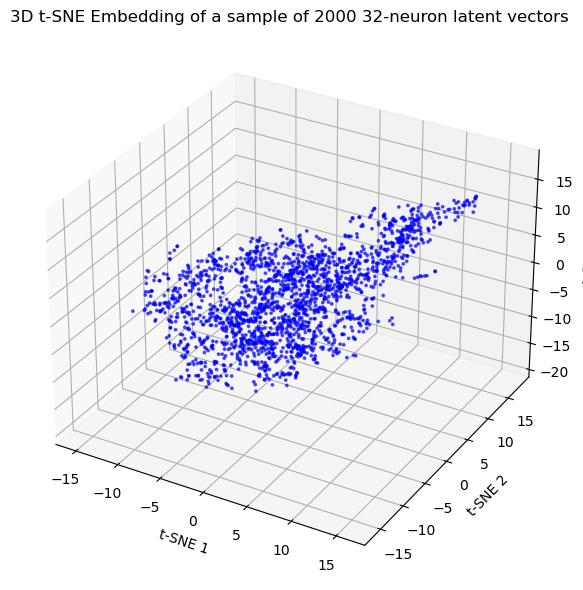

In [ ]:
# Sample a subset to make t-SNE computationally feasible
np.random.seed(42)
sample_indices = np.random.choice(image_latent_patches_s.shape[0], size=2000, replace=False)
sampled_vectors = image_latent_patches_s[sample_indices]

# Run t-SNE
tsne = TSNE(n_components=3, perplexity=30, n_iter=2000, init='random', random_state=42)
embedded = tsne.fit_transform(sampled_vectors)

# 3D Plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(embedded[:, 0], embedded[:, 1], embedded[:, 2],
           c='blue', s=3, alpha=0.6)

ax.set_title('3D t-SNE Embedding of a sample of 2000 32-neuron latent vectors')
ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
ax.set_zlabel('t-SNE 3')
plt.tight_layout()
plt.show()

## Optimal k clustering for image latent vectors

### Evaluating number of cluster for kmeans
Use the elbow method to find optimal k clusters. Then run the clustering for optimal k.

100%|██████████| 18/18 [04:13<00:00, 14.06s/it]


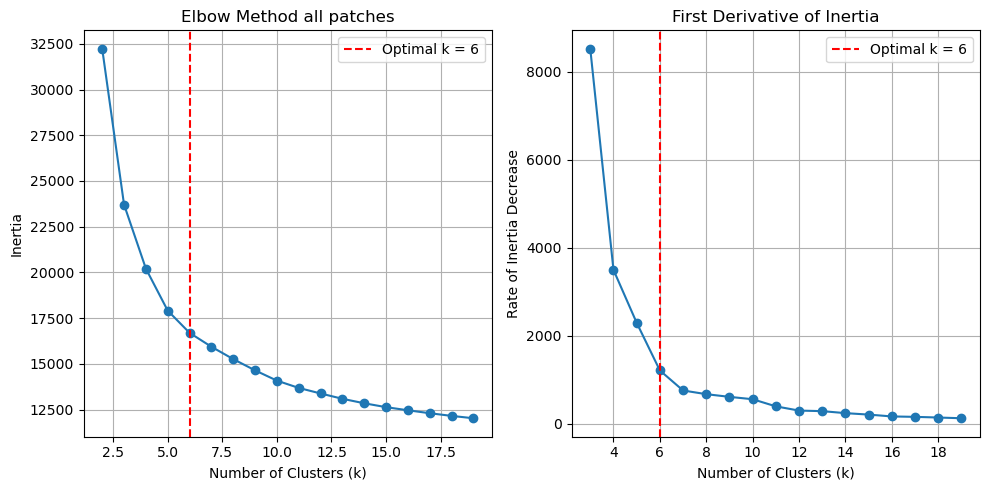

In [ ]:
k_values = range(2, 20)

inertia_values_all = []

# Run K-means for different cluster numbers
for k in tqdm(k_values):
    kmeans = KMeans(n_clusters=k, random_state=27, n_init=10)
    kmeans.fit(image_latent_patches_s)
    inertia_values_all.append(kmeans.inertia_)

inertia_diff_all = np.diff(inertia_values_all)

knee_all = KneeLocator(k_values, inertia_values_all, curve="convex", direction="decreasing")
optimal_k_all = knee_all.knee

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(k_values, inertia_values_all, marker='o', linestyle='-')
plt.axvline(x=optimal_k_all, color='red', linestyle='--', label=f'Optimal k = {optimal_k_all}')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia")
plt.title("Elbow Method all patches")
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(k_values[1:], -inertia_diff_all, marker='o', linestyle='-')
plt.axvline(x=optimal_k_all, color='red', linestyle='--', label=f'Optimal k = {optimal_k_all}')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Rate of Inertia Decrease")
plt.title("First Derivative of Inertia")
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

### Optimal kmeans

In [ ]:
# optimalk_all = 7
kmeansall = KMeans(n_clusters=7, random_state=27, n_init=10)
kmeanslabels = kmeansall.fit_predict(image_latent_patches_s)

## Stage 1
According to workflow from my report/presentation

In [23]:
def sliding_window(image, window_size, stride):
    '''
    Extracts square patches from a 2D image using a sliding window approach.

    Description:
        This function moves a fixed-size window across the input image at defined strides.
        At each position, it extracts a patch (sub-array) and records the top-left coordinate
        of that patch within the original image.

    Inputs:
        image (np.ndarray): 2D input image array of shape (H, W).
        window_size (int): Size of the square window (window_size x window_size).
        stride (int): Step size to move the window in both vertical and horizontal directions.

    Outputs:
        patches (List[np.ndarray]): List of extracted image patches, each of shape (window_size, window_size).
        positions (List[Tuple[int, int]]): List of (row, col) coordinates indicating the top-left corner
                                           of each extracted patch in the original image.
    '''
    h, w, = image.shape
    patches = []
    positions = []
    for i in range(0, h - window_size + 1, stride):
        for j in range(0, w - window_size + 1, stride):
            patch = image[i:i + window_size, j:j + window_size]
            patches.append(patch)
            positions.append((i, j))
    return patches, positions

def mode_image(image, encoder, cluster_model, scaler, window_size=tile_size, stride=2):
    '''
    Generates a characterisation map of an image by encoding patches and clustering their latent features.

    Description:
        This function slides a window across the input image to extract patches. Each patch is encoded 
        using a trained encoder to obtain a latent representation, which is then standardised and clustered. 
        The resulting cluster labels are used to assign each pixel a class based on majority voting from 
        overlapping patches. The final output is a 2D map of cluster assignments.

    Inputs:
        image: 2D input array representing the image.
        encoder: Trained encoder model that outputs latent vectors from image patches.
        cluster_model: Clustering model (e.g. KMeans, DBSCAN, HDBSCAN) used to classify latent vectors.
        scaler: Fitted scaler used to normalise latent vectors before clustering.
        window_size: Size of the sliding window (default: tile_size).
        stride: Number of pixels the window moves in each direction (default: 2).

    Outputs:
        char_map: 2D array of the same shape as the input image, where each pixel is assigned a cluster label.
                  Pixels that are not assigned to any cluster are marked with -1.
    '''
    patches, positions = sliding_window(image, window_size, stride)

    # Get latent vectors for all patches
    latent_vector_patch = [encoder(patch.reshape(1, window_size, window_size, 1)).numpy().flatten()
                           for patch in tqdm(patches)]
    latent_flattened = np.array(latent_vector_patch)


    latent_flattened = scaler.transform(latent_flattened)

    # Clustering
    cluster_ids = cluster_model.fit_predict(latent_flattened)

    # Initialize character map and vote storage
    char_map = np.full(image.shape[:2], -1, dtype=int)  # Initialize as -1 (unassigned)
    vote_dict = {}  # Stores votes for each pixel location

    for (i, j), cluster_id in zip(positions, cluster_ids):
        if cluster_id == -1:
            continue  # Ignore noise
        for x in range(i, i + window_size):
            for y in range(j, j + window_size):
                if 0 <= x < image.shape[0] and 0 <= y < image.shape[1]:  # Ensure within bounds
                    if (x, y) not in vote_dict:
                        vote_dict[(x, y)] = []
                    vote_dict[(x, y)].append(cluster_id)

    # Apply majority voting per pixel
    for (x, y), votes in vote_dict.items():
        char_map[x, y] = Counter(votes).most_common(1)[0][0]  # Most common cluster ID

    return char_map

def find_medoids(latent_vectors_train, labels, sample_size=100):
    unique_labels = np.unique(labels)
    medoids = []

    for label in tqdm(unique_labels):
        # Get points belonging to the current cluster
        cluster_points = latent_vectors_train[labels == label]
        n_points = len(cluster_points)

        # Reduce computations for large clusters by sampling
        if n_points > sample_size:
            sampled_indices = np.random.choice(n_points, size=sample_size, replace=False)
            cluster_points = cluster_points[sampled_indices]

        # Compute pairwise distances within the sampled cluster
        distances = pairwise_distances(cluster_points)

        # Find the medoid (point with the smallest sum of distances)
        medoid_index = np.argmin(distances.sum(axis=0))
        medoids.append(cluster_points[medoid_index])

    return np.array(medoids)

def compareimage_choose(original, char, selected_group=None):
    '''ChatGPTed'''
    fig, ax = plt.subplots(1, 4, figsize=(15, 5), dpi=500)

    # First image: Original
    ax[0].imshow(original, origin='upper', cmap='viridis')
    ax[0].set_title('Original Image')
    
    ax[1].imshow(char, cmap='RdBu')
    ax[1].set_title('Character Map')

    # Second image: Character map (filtered if group selected)
    if selected_group is not None:
        char_filtered = np.where(char == selected_group, char, np.nan)  # Set non-selected groups to NaN
        ax[2].imshow(original, cmap='viridis')
        color = ax[2].imshow(char_filtered, cmap='RdBu', origin='upper', vmin=np.nanmin(char), vmax=np.nanmax(char))
        ax[2].set_title(f'Character map (Group {selected_group})')
    else:
        color = ax[2].imshow(char, cmap='RdBu', origin='upper')
        ax[2].set_title('Character map (All groups)')

    fig.colorbar(color, ax=ax[1], orientation='vertical', fraction=0.05)

    # Third image: Overlay
    im = ax[3].imshow(original, origin='upper', cmap='viridis')
    im_overlay = ax[3].imshow(char, alpha=0.4, cmap='RdBu', origin='upper')
    fig.colorbar(im_overlay, ax=ax[3], orientation='vertical', fraction=0.05)
    ax[3].set_title('Overlay')

    for axs in ax:
        axs.axis('off')

    plt.show()

def interactive_compareimage(og, char):
    '''ChatGPTed'''
    unique_groups = np.unique(char[char != -1])  # Exclude noise if needed
    
    def update(selected_group):
        compareimage_choose(og, char, selected_group)
    
    interact(update, selected_group=[None] + list(unique_groups))  # Add None for all groups

def extract_high_error_patches(original_image, model, tile_size=32, stride=8, min_dist=10, plot_maps=False, plot_defects=False):
    '''
    Identifies and extracts high-error patches from an image using autoencoder reconstruction error.

    Description:
        This function slides a window across the input image and reconstructs each patch using a trained
        autoencoder model. The reconstruction error is computed for each patch and aggregated into an 
        error map. High-error regions are extracted based on a dynamic threshold, and optionally filtered 
        using non-maximum suppression to avoid duplicates. Visualisation options are available to inspect
        both the error map and the detected defect patches.

    Inputs:
        original_image: 2D input array representing the image.
        model: Trained autoencoder model used for patch reconstruction.
        tile_size: Size of the square patch to slide over the image (default: 32).
        stride: Step size for the sliding window (default: 8).
        min_dist: Minimum distance between extracted defect centres (default: 10).
        plot_maps: If True, plots the original image, error map, and defect locations (default: False).
        plot_defects: If True, displays the extracted defect patches in a grid (default: False).

    Outputs:
        error_map: 2D array of the same shape as the input image containing smoothed reconstruction error values.
        defect_patches: List of 2D arrays representing extracted high-error patches.
        centers: List of (x, y) tuples indicating the coordinates of each extracted patch's centre.
    '''

    h, w = original_image.shape
    half_tile = tile_size // 2

    error_map = np.zeros((h, w))
    count_map = np.zeros((h, w))

    # Step 1: Compute reconstruction error map
    for y in tqdm(range(0, h, stride)):
        for x in range(0, w, stride):
            y1, y2 = min(y, h - tile_size), min(y + tile_size, h)
            x1, x2 = min(x, w - tile_size), min(x + tile_size, w)

            patch = original_image[y1:y2, x1:x2]
            if patch.shape != (tile_size, tile_size):
                patch = cv2.copyMakeBorder(patch, 0, tile_size - patch.shape[0], 0, tile_size - patch.shape[1], cv2.BORDER_REFLECT)

            patch_input = patch.reshape(1, tile_size, tile_size, 1)
            reconstructed_patch = model.predict(patch_input, verbose=0)[0].reshape(tile_size, tile_size)

            error_patch = np.abs(patch - reconstructed_patch) ** 2
            error_map[y1:y2, x1:x2] += error_patch
            count_map[y1:y2, x1:x2] += 1

    count_map[count_map == 0] = 1
    error_map /= count_map
    raw_map = error_map.copy()

    # Step 2: Smooth error map and compute threshold
    sigma = max(2, np.std(error_map) / 5)
    error_map = gaussian_filter(error_map, sigma=sigma)

    error_skewness = skew(raw_map.flatten())
    threshold_percentile = 97 + 2 * min(1, error_skewness)
    threshold = np.percentile(error_map, threshold_percentile)

    high_error_ratio = np.sum(error_map > threshold) / error_map.size
    if high_error_ratio > 0.2:
        error_map = np.max(error_map) - error_map
        print("Error map flipped due to high error coverage.")

    defect_mask = (error_map > threshold).astype(np.uint8)

    # Step 3: Label and extract defect regions
    labeled_mask, num_labels = nd_label(defect_mask)
    defect_patches, centers, error_values = [], [], []

    for label_idx in range(1, num_labels + 1):
        region_mask = (labeled_mask == label_idx)
        y, x = center_of_mass(region_mask)

        if np.isnan(y) or np.isnan(x):
            continue

        y, x = int(round(y)), int(round(x))
        y = np.clip(y, half_tile, h - half_tile - 1)
        x = np.clip(x, half_tile, w - half_tile - 1)

        y1, y2 = max(0, y - half_tile), min(h, y + half_tile)
        x1, x2 = max(0, x - half_tile), min(w, x + half_tile)
        patch = original_image[y1:y2, x1:x2]

        if patch.shape != (tile_size, tile_size):
            patch = cv2.copyMakeBorder(
                patch,
                top=max(0, half_tile - y), bottom=max(0, y + half_tile - h),
                left=max(0, half_tile - x), right=max(0, x + half_tile - w),
                borderType=cv2.BORDER_CONSTANT, value=0
            )

        defect_patches.append(patch)
        centers.append((x, y))
        error_values.append(error_map[y, x])

    # Step 4: Non-Maximum Suppression
    if min_dist > 0 and defect_patches:
        filtered_centers, filtered_patches = [], []
        error_values = np.array(error_values)
        sorted_indices = np.argsort(-error_values)
        selected = np.zeros(len(centers), dtype=bool)

        for i in sorted_indices:
            if selected[i]:
                continue
            x1, y1 = centers[i]
            filtered_centers.append((x1, y1))
            filtered_patches.append(defect_patches[i])
            selected[i] = True

            distances = np.linalg.norm(np.array(centers) - np.array([x1, y1]), axis=1)
            selected[distances < min_dist] = True

        centers, defect_patches = filtered_centers, filtered_patches

    # Step 5: Visualise maps
    if plot_maps:
        fig, axs = plt.subplots(1, 3, figsize=(15, 5), dpi=150)
        axs[0].imshow(original_image, cmap='viridis')
        axs[0].set_title('Original STM Image')

        axs[1].imshow(error_map, cmap='hot')
        axs[1].set_title(f'Error Map (Threshold: {threshold_percentile:.2f})')

        axs[2].imshow(original_image, cmap='viridis')
        axs[2].set_title('Detected Defects')

        for x, y in centers:
            axs[1].scatter(x, y, color='green', marker='x', lw=1, s=10)
            axs[2].scatter(x, y, color='black', marker='x', lw=1, s=10)

        for ax in axs:
            ax.axis('off')
        plt.show()

    # Step 6: Visualise patches
    if plot_defects and defect_patches:
        num_patches = len(defect_patches)
        grid_size = ceil(sqrt(num_patches))
        fig, axs = plt.subplots(grid_size, grid_size, figsize=(grid_size * 2, grid_size * 2))
        axs = axs.flatten()

        for i, patch in enumerate(defect_patches):
            axs[i].imshow(patch, cmap='viridis')
            axs[i].axis('off')
            axs[i].set_title(f'Defect {i+1}')

        for j in range(i + 1, len(axs)):
            axs[j].axis('off')

    return error_map, defect_patches, centers

def generate_fine_characterization_mask(original_image, char_map, error_map, defect_centers, error_percentile=90, plot_mask=False):
    """
    Generates a binary mask highlighting regions for fine-grained characterization.
    """
    target_clusters = [
        char_map[x, y]
        for (x, y) in defect_centers
        if 0 <= y < char_map.shape[0] and 0 <= x < char_map.shape[1]
    ]

    assert original_image.shape == char_map.shape == error_map.shape, "All input maps must be the same shape."

    # Step 1: High-error pixels
    error_threshold = np.percentile(error_map, error_percentile)
    high_error_mask = error_map > error_threshold
    print(f"High-error threshold: {error_threshold:.4f}, pixels above threshold: {np.sum(high_error_mask)}")

    # Step 2: Pixels in target clusters
    cluster_mask = np.isin(char_map, target_clusters)
    print(f"Target cluster match pixels: {np.sum(cluster_mask)}")

    # Step 3: Combine (OR)
    fine_characterization_mask = (high_error_mask & cluster_mask).astype(np.uint8)
    print(f"Final fine mask nonzero pixels: {np.sum(fine_characterization_mask)}")

    # Optional plotting
    if plot_mask:
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 4, 1)
        plt.imshow(original_image, cmap='viridis')
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(char_map, cmap='tab10')
        plt.title('Characterization Map')
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(error_map, cmap='hot')
        plt.title('Error Map')
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(original_image, cmap='viridis')
        plt.imshow(fine_characterization_mask, cmap='gray', alpha=0.7)
        plt.title('Fine Characterization Mask')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    return fine_characterization_mask


def clean_and_round_blobs(mask, shrink_iterations=3, grow_iterations=5, kernel_size=5,
                          line_threshold=1.2, sigma=0.2, plot_mask=True):
    '''
    Cleans and rounds detected blobs in a binary mask by removing elongated regions and smoothing shapes.

    Description:
        This function refines a binary blob mask by first shrinking it (erosion), applying Gaussian smoothing, 
        and then expanding it (dilation). It then removes line-like or elongated regions based on aspect ratio,
        leaving only more compact and circular blobs. Visualisation of the processing steps is optional.

    Inputs:
        mask: 2D binary numpy array where blobs are marked with 1 (foreground) and background with 0.
        shrink_iterations: Number of erosion passes to apply (default: 3).
        grow_iterations: Number of dilation passes to apply after smoothing (default: 5).
        kernel_size: Size of the elliptical structuring element used for morphological operations (default: 5).
        line_threshold: Minimum aspect ratio (length/width) to consider a region as an elongated line (default: 1.2).
        sigma: Standard deviation for Gaussian filter applied after erosion (default: 0.2).
        plot_mask: If True, visualises intermediate processing steps (default: True).

    Outputs:
        clean_mask: 2D binary numpy array with cleaned, rounded blobs (elongated lines removed).
    '''

    # Create elliptical structuring element
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Step 1: Shrink blobs
    eroded_mask = cv2.erode(mask, kernel, iterations=shrink_iterations)

    # Step 2: Smooth with Gaussian filter
    gauss_mask = gaussian_filter(eroded_mask.astype(float), sigma=sigma)
    gauss_mask = (gauss_mask > 0.95).astype(np.uint8)

    # Step 3: Grow blobs
    if grow_iterations > 0:
        grown_mask = cv2.dilate(gauss_mask, kernel, iterations=grow_iterations)
    else:
        grown_mask = gauss_mask
    # Step 4: Label and filter elongated regions
    labeled_mask = nd_label(grown_mask > 0)[0]  # Binarise and label connected components
    clean_mask = np.zeros_like(labeled_mask)

    for region in measure.regionprops(labeled_mask):
        min_row, min_col, max_row, max_col = region.bbox
        height = max_row - min_row
        width = max_col - min_col
        aspect_ratio = max(height / (width + 1e-5), width / (height + 1e-5))

        if aspect_ratio < line_threshold:
            clean_mask[min_row:max_row, min_col:max_col] = (
                labeled_mask[min_row:max_row, min_col:max_col] == region.label
            )

    # Step 5: Plot if required
    if plot_mask:
        fig, axes = plt.subplots(1, 5, figsize=(25, 5))
        titles = ['Original Mask', 'Eroded', 'Gaussian Smoothed', 'Grown', 'Lines Removed']
        images = [mask, eroded_mask, gauss_mask, grown_mask, clean_mask]

        for ax, img, title in zip(axes, images, titles):
            ax.imshow(img, cmap='gray')
            ax.set_title(title)
            ax.axis('off')

        plt.tight_layout()
        plt.show()

    return clean_mask

def clean_defect_mask(binary_mask, min_area=75, kernel_size=3):
    '''
    Cleans a binary defect mask by removing noise and small components.

    Description:
        This function refines a binary mask by first removing connected regions smaller
        than a specified area threshold. It then applies morphological opening to smooth
        boundaries and eliminate thin artifacts or isolated pixels.

    Inputs:
        binary_mask: 2D binary array (0/1 or boolean) representing the defect mask.
        min_area: Minimum size (in pixels) of a connected region to keep (default: 75).
        kernel_size: Size of the square structuring element used in morphological opening (default: 3).

    Outputs:
        cleaned_mask: 2D binary array of the same shape as the input, with small and noisy components removed.
    '''

    # Ensure binary input
    binary_mask = (binary_mask > 0).astype(np.uint8)

    # Step 1: Remove small connected components
    labels = measure.label(binary_mask, connectivity=2)
    cleaned_mask = np.zeros_like(binary_mask)

    for region in measure.regionprops(labels):
        if region.area >= min_area:
            cleaned_mask[labels == region.label] = 1

    # Step 2: Morphological opening
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    cleaned_mask = cv2.morphologyEx(cleaned_mask, cv2.MORPH_OPEN, kernel)

    return cleaned_mask

def extract_masked_patches_and_cluster(original_image, fine_mask, encoder, clusterer, scaler, 
                                       tile_size=32, min_dist=16, 
                                       plot_overlay=True, plot_defects=True):
    """
    Extracts patches from a fine characterization mask and clusters them using a latent encoder.
    """

    h, w = original_image.shape
    half_tile = tile_size // 2

    labeled_mask, num_labels = nd_label(fine_mask)

    defect_patches = []
    centers = []
    used_centres = []
    locked_centres = []
    stride = min_dist

    for region in measure.regionprops(labeled_mask):
        cy, cx = map(int, map(round, region.centroid))
        y0, x0, y1, x1 = region.bbox
        region_h, region_w = y1 - y0, x1 - x0

        if region_h <= tile_size and region_w <= tile_size:
            # Small region: single patch
            y1_patch = max(0, min(h - tile_size, cy - half_tile))
            x1_patch = max(0, min(w - tile_size, cx - half_tile))
            centre = (x1_patch + half_tile, y1_patch + half_tile)

            # Skip if too close to a previously used small patch
            if any(np.hypot(uc[0] - centre[0], uc[1] - centre[1]) < stride for uc in used_centres):
                continue

            patch = original_image[y1_patch:y1_patch + tile_size, x1_patch:x1_patch + tile_size]
            if patch.shape == (tile_size, tile_size):
                norm_patch = (patch - np.min(patch)) / (np.max(patch) - np.min(patch) + 1e-8)
                defect_patches.append(norm_patch)
                centers.append(centre)
                used_centres.append(centre)
                locked_centres.append(centre)  # ← lock small-region centre


        else:
            # Large region: tile with stride, avoiding overlap
            num_y_tiles = max(1, floor((region_h - tile_size) / stride) + 1)
            num_x_tiles = max(1, floor((region_w - tile_size) / stride) + 1)

            for i in range(num_y_tiles):
                for j in range(num_x_tiles):
                    y = y0 + i * stride
                    x = x0 + j * stride
                    centre = (x + half_tile, y + half_tile)

                    if y + tile_size > h or x + tile_size > w:
                        continue

                    # Check if too close to any locked small-region centre
                    if any(np.hypot(lc[0] - centre[0], lc[1] - centre[1]) < stride for lc in locked_centres):
                        continue  # ← this is new and prioritises small-region centres

                    # Then check global spacing as usual
                    if any(np.hypot(uc[0] - centre[0], uc[1] - centre[1]) < stride for uc in used_centres):
                        continue


                    patch = original_image[y:y + tile_size, x:x + tile_size]
                    if patch.shape == (tile_size, tile_size):
                        norm_patch = (patch - np.min(patch)) / (np.max(patch) - np.min(patch) + 1e-8)
                        defect_patches.append(norm_patch)
                        centers.append(centre)
                        used_centres.append(centre)

    if not defect_patches:
        return [], [], []

    print(f"Number of regions detected: {len(defect_patches)}")

    # Step 2: Encode and scale features
    defect_array = np.array(defect_patches)
    defect_features = encoder.predict(defect_array)
    defect_features = scaler.transform(defect_features)

    # Step 3: Clustering
    if len(defect_features) < 20:
        cluster_labels = clusterer.predict(defect_features)
    
    else: 
        cluster_labels = clusterer.fit_predict(defect_features)

    # Step 4: Visualise overlay
    if plot_overlay:
        plt.figure(figsize=(8, 8), dpi=100)
        plt.imshow(original_image, cmap='viridis')
        ax = plt.gca()

        for (x, y), cluster in zip(centers, cluster_labels):
            rect = plt.Rectangle((x - half_tile, y - half_tile), tile_size, tile_size,
                                 linewidth=1.5, edgecolor='k', facecolor='none')
            ax.add_patch(rect)
            plt.text(x + 16, y + 16, str(cluster), color='red', fontsize=10,
                     ha='center', va='center')

        plt.title("Clustered Defects from Fine Mask")
        plt.axis('off')
        plt.show()

    # Step 5: Plot grouped patches
    if plot_defects:
        print('Plotting')
        sorted_idx = np.argsort(cluster_labels)
        sorted_patches = [defect_patches[i] for i in sorted_idx]
        sorted_labels = [cluster_labels[i] for i in sorted_idx]

        num_patches = len(sorted_patches)
        grid_size = ceil(sqrt(num_patches))
        fig, axs = plt.subplots(grid_size, grid_size, figsize=(grid_size * 2, grid_size * 2))
        axs = axs.flatten()

        for i, (patch, label) in enumerate(zip(sorted_patches, sorted_labels)):
            axs[i].imshow(patch, cmap='viridis', vmin=0, vmax=1)
            axs[i].axis('off')
            axs[i].set_title(f'Group {label}')

        for j in range(i + 1, len(axs)):
            axs[j].axis('off')

        plt.tight_layout()
        plt.show()

    return cluster_labels, defect_patches, centers

## Stage 1 run through

In [ ]:
# Set image to analyse
image = (data[(data['Type'] == 'Predict')].iloc[7]['Image'])

# Generate the character map using the kmeans clustering
char_map = mode_image(image, encoder_split, kmeansall, stride=4)

# Compare input and character map
interactive_compareimage(image, char_map)

# Generate the error map
error_map, defect_patches, defect_centers = extract_high_error_patches(image, model, stride=24, plot_maps=True)

fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=1,
    kernel_size=5,
    line_threshold=2,
    sigma=0.1)


# Clustering the defects using the kmeans labels
cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, encoder_split, kmeansall, scaler, min_dist=16, plot_defects=True)

## Extracting defects from all images
Here we iterate though all images and extract the defects from all images. Again send off to HPC to bring down computation time. Do very small slice of array if running locally.

### Code to extract defects

In [ ]:
all_defect_patches = []

for idx, val in enumerate(data['Image']):
    image = val
    image_id = idx
    print(idx, image.shape)
    if image.shape < (32,32):
        continue
    # Step 1: Generate character map and reconstruction error map
    char_map = mode_image(image, encoder_split, kmeansall, stride=8)
    error_map, defect_patches, defect_centers = extract_high_error_patches(
        image, model, stride=30, plot_maps=False)

    # Step 2: Generate and clean defect mask
    fine_map = generate_fine_characterization_mask(
        image, char_map, error_map, defect_centers, plot_mask=False, error_percentile=90)

    cleaned_mask = clean_defect_mask(fine_map, min_area=50)
    eroded_mask = clean_and_round_blobs(
        cleaned_mask,
        shrink_iterations=1,
        grow_iterations=1,
        kernel_size=5,
        line_threshold=2,
        sigma=0.1,
        plot_mask=False
    )

    # Step 3: Extract encoded defect patches and cluster
    cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
        image, eroded_mask, encoder_split, kmeansall, scaler, min_dist=16, plot_overlay=False, plot_defects=False)

    # Step 4: Store outputs
    all_defect_patches.extend(filtered_patches)
    print(len(all_defect_patches))

### Load defects array

In [ ]:
all_defects_array = np.load('defect_patches_unknown.npy')

## Clean up the defects
Removes edge cases, grid patterned images (that for some reason show up), and low entropy (hopefully only lattice pattern image).

100%|██████████| 400/400 [01:51<00:00,  3.60it/s]


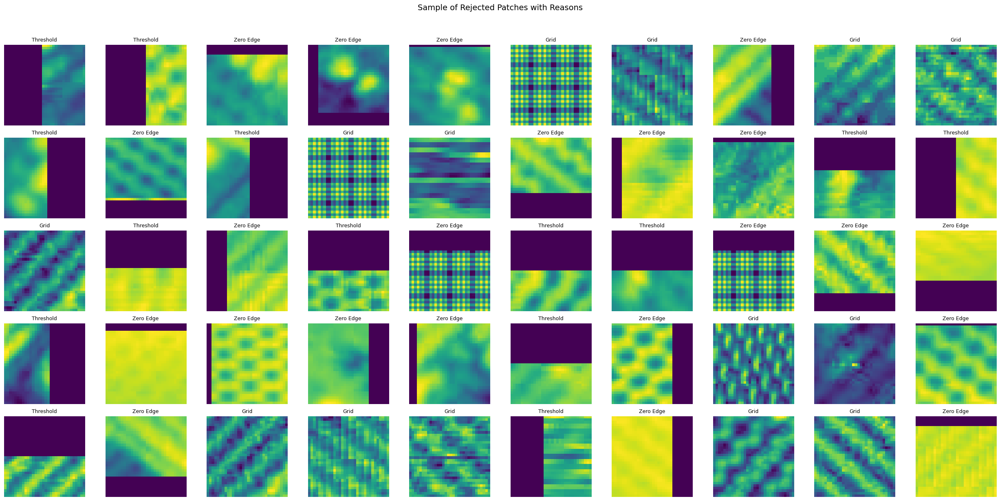

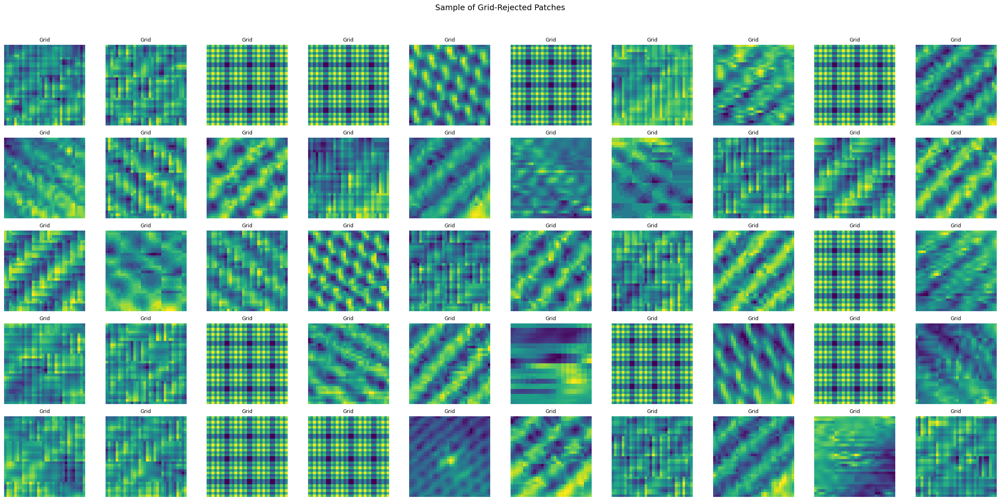

No entropy rejected patches found.
Finished
(321002, 32, 32)
(105930, 32, 32)
3311/3311 ━━━━━━━━━━━━━━━━━━━━ 84s 25ms/step
(105930, 8)


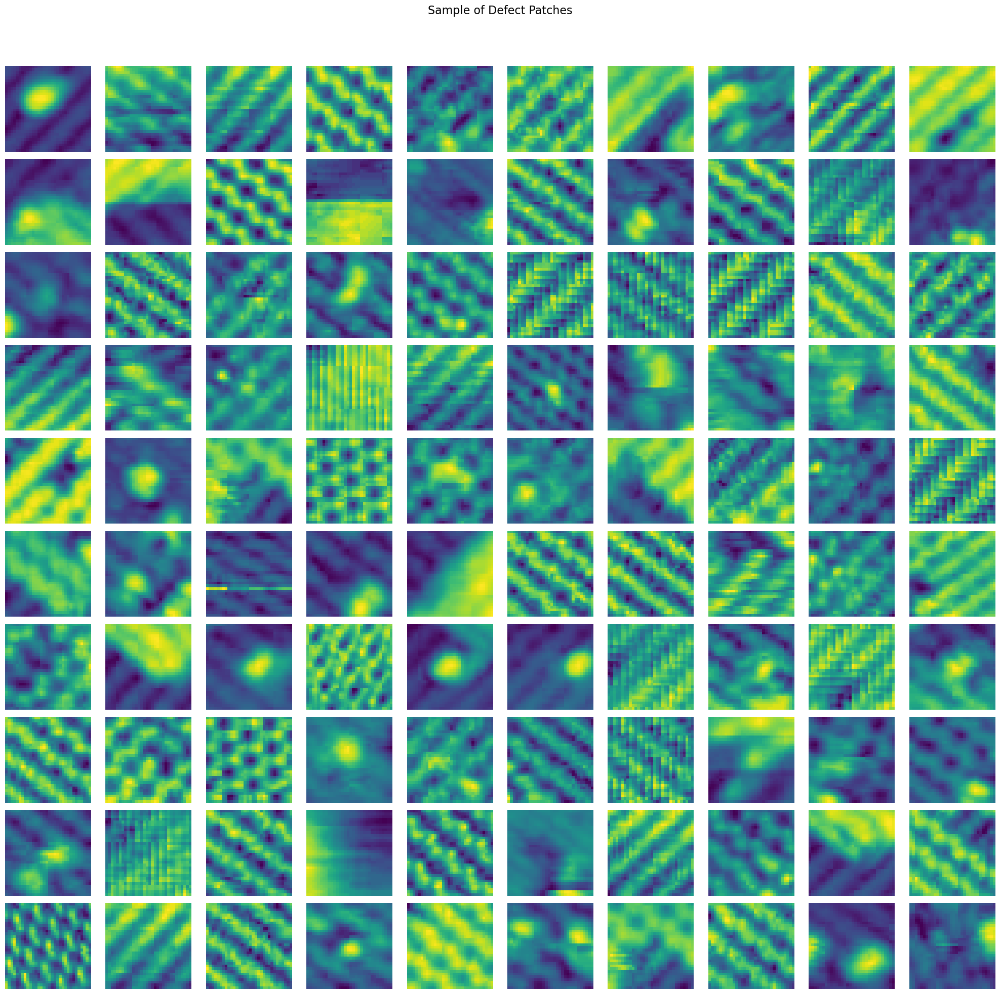

In [ ]:
def has_solid_zero_edge(patch, width=2):
    # Check for fully-zero top or bottom edge rows
    top_rows = patch[:width, :]
    bottom_rows = patch[-width:, :]
    top_bad = np.any(np.all(top_rows == 0, axis=1))
    bottom_bad = np.any(np.all(bottom_rows == 0, axis=1))

    # Check for fully-zero left or right edge columns
    left_cols = patch[:, :width]
    right_cols = patch[:, -width:]
    left_bad = np.any(np.all(left_cols == 0, axis=0))
    right_bad = np.any(np.all(right_cols == 0, axis=0))

    return top_bad or bottom_bad or left_bad or right_bad

def has_grid_pattern_fft(patch, threshold=0.47):
    """
    Detects grid-like artefacts based on energy in high-frequency FFT components.
    """
    f = np.fft.fft2(patch)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = np.abs(fshift)

    # Mask the low-frequency centre
    h, w = patch.shape
    centre_size = 6  # Size of the low-frequency square to exclude
    mask = np.ones((h, w), dtype=bool)
    mask[h//2 - centre_size:h//2 + centre_size, w//2 - centre_size:w//2 + centre_size] = 0

    high_freq_energy = magnitude_spectrum[mask].mean()
    total_energy = magnitude_spectrum.mean()

    return (high_freq_energy / total_energy) > threshold


from skimage.measure import shannon_entropy

def has_low_entropy(patch, entropy_threshold=3):
    return shannon_entropy(patch) < entropy_threshold

def check_patch_rejection_reason(patch):
    if has_solid_zero_edge(patch):
        return "Zero Edge"
    elif has_grid_pattern_fft(patch, threshold=0.45):
        return "Grid"
    elif has_low_entropy(patch, entropy_threshold=2):
        return "Low Entropy"
    else:
        return None


def collect_and_plot_rejected_with_labels(rejected_with_reasons, sample_size=100):
    """
    Plot a sample of rejected patches with labels showing rejection reason.

    Parameters:
    - rejected_with_reasons: list of (patch, reason) tuples
    - sample_size: number of patches to display
    """
    if len(rejected_with_reasons) == 0:
        print("No rejected patches to display.")
        return

    sample_size = min(sample_size, len(rejected_with_reasons))
    sampled = random.sample(rejected_with_reasons, k=sample_size)

    patches = [item[0] for item in sampled]
    labels = [item[1] for item in sampled]

    cols = 10
    rows = int(np.ceil(sample_size / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.5, rows * 2.5))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < sample_size:
            ax.imshow(patches[i], cmap='viridis')
            ax.set_title(labels[i], fontsize=9)
            ax.axis('off')
        else:
            ax.remove()

    plt.suptitle("Sample of Rejected Patches with Reasons", fontsize=14)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

def plot_only_grid_rejected_patches(rejected_with_reasons, sample_size=16):
    """
    Plot only the rejected patches labelled as 'Grid'.
    """
    # Filter to just the 'Grid' examples
    grid_rejections = [item for item in rejected_with_reasons if item[1] == "Grid"]

    if len(grid_rejections) == 0:
        print("No grid-like rejected patches found.")
        return

    sample_size = min(sample_size, len(grid_rejections))
    import random
    sampled = random.sample(grid_rejections, k=sample_size)

    patches = [item[0] for item in sampled]

    # Plotting
    cols = 10
    rows = int(np.ceil(sample_size / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.5, rows * 2.5))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < sample_size:
            ax.imshow(patches[i], cmap='viridis')
            ax.set_title("Grid", fontsize=9)
            ax.axis('off')
        else:
            ax.remove()

    plt.suptitle("Sample of Grid-Rejected Patches", fontsize=14)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

def plot_only_ent_rejected_patches(rejected_with_reasons, sample_size=16):
    """
    Plot only the rejected patches labelled as 'Low Entropy'.
    """
    # Filter to just the 'Grid' examples
    grid_rejections = [item for item in rejected_with_reasons if item[1] == "Low Entropy"]

    if len(grid_rejections) == 0:
        print("No entropy rejected patches found.")
        return

    sample_size = min(sample_size, len(grid_rejections))
    import random
    sampled = random.sample(grid_rejections, k=sample_size)

    patches = [item[0] for item in sampled]

    # Plotting
    cols = 10
    rows = int(np.ceil(sample_size / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.5, rows * 2.5))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < sample_size:
            ax.imshow(patches[i], cmap='viridis')
            ax.set_title("Entropy", fontsize=9)
            ax.axis('off')
        else:
            ax.remove()

    plt.suptitle("Sample of Entropy-Rejected Patches", fontsize=14)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

def filter_and_normalise_patches_chunked(memmap_array, batch_size=1000, threshold=0.4):
    """
    Process large .npy array in chunks: filter patches by zero-pixel ratio
    and edge artefacts, then normalise each patch to [0, 1] range.
    """
    N = memmap_array.shape[0]
    results = []
    rejected_with_reasons = []  # (patch, reason) tuples

    for i in tqdm(range(0, N, batch_size)):
        batch = memmap_array[i:i+batch_size]

        # Compute zero pixel fractions
        zero_pixel_fraction = np.sum(batch == 0, axis=(1, 2)) / (32 * 32)
        valid_mask = zero_pixel_fraction < threshold
        threshold_rejected = batch[~valid_mask]
        for patch in threshold_rejected:
            rejected_with_reasons.append((patch, "Threshold"))

        # Proceed with only valid patches
        filtered = batch[valid_mask]

        # Further filter out artefacts
        refined = []
        for patch in filtered:
            reason = check_patch_rejection_reason(patch)
            if reason is not None:
                rejected_with_reasons.append((patch, reason))
            else:
                refined.append(patch)


        if not refined:
            continue

        refined = np.stack(refined, axis=0)

        # Normalise to [0, 1]
        min_vals = refined.reshape(refined.shape[0], -1).min(axis=1, keepdims=True)
        max_vals = refined.reshape(refined.shape[0], -1).max(axis=1, keepdims=True)
        ranges = max_vals - min_vals + 1e-8

        normalised = ((refined.reshape(refined.shape[0], -1) - min_vals) / ranges).reshape(-1, 32, 32)
        results.append(normalised)

    # Plot a sample of all rejected patches, labelled by reason
    collect_and_plot_rejected_with_labels(rejected_with_reasons, sample_size=50)
    plot_only_grid_rejected_patches(rejected_with_reasons, sample_size=50)
    plot_only_ent_rejected_patches(rejected_with_reasons, sample_size=50)

    return np.concatenate(results, axis=0)

def plot_image_patch_sample(patches, sample_size=36, title="Sample of Defect Patches"):
    """
    Display a random sample of image patches from the array.
    
    Parameters:
    - patches: numpy array of shape (N, H, W)
    - sample_size: number of patches to show
    - title: plot title
    """
    if len(patches) == 0:
        print("No patches to display.")
        return

    sample_size = min(sample_size, len(patches))
    indices = np.random.choice(len(patches), size=sample_size, replace=False)
    sampled = patches[indices]

    cols = 10
    rows = int(np.ceil(sample_size / cols))
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < sample_size:
            ax.imshow(sampled[i], cmap='viridis')
            ax.axis('off')
        else:
            ax.remove()

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()

# (504675, 32, 32) for memmap
patches_memmap = np.load('defect_patches_unknown.npy', mmap_mode='r')
all_defects_array = filter_and_normalise_patches_chunked(patches_memmap[0:400000], batch_size=1000)
print('Finished')
print(all_defects_array.shape)

sample_indices = np.random.choice(all_defects_array.shape[0], size=int(0.33*(all_defects_array.shape[0])), replace=False)
defect_sample = all_defects_array[sample_indices]

print(defect_sample.shape)

plot_image_patch_sample(defect_sample, sample_size=100)

## Setting up and training Autoencoder 2
This is the autoencoder is trained on the extracted defects

### Train AE2

In [ ]:
input_layer = keras.layers.Input(shape=(32, 32, 1))

# Encoder
x = keras.layers.Conv2D(64, 3, padding='same', kernel_regularizer=regularizers.l2(1e-4))(input_layer)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('relu')(x)
x = keras.layers.MaxPooling2D(2, padding='same')(x)

x = keras.layers.Conv2D(128, 3, padding='same', kernel_regularizer=regularizers.l2(1e-4))(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('relu')(x)
x = keras.layers.MaxPooling2D(2, padding='same')(x)

x = keras.layers.Conv2D(256, 3, padding='same', kernel_regularizer=regularizers.l2(1e-4))(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('relu')(x)
x = keras.layers.MaxPooling2D(2, padding='same')(x)
x = keras.layers.Dropout(0.2)(x)

# Latent space
flat = keras.layers.Flatten()(x)
latent = keras.layers.Dense(10, activation='relu')(flat)

# Decoder
x = keras.layers.Dense(4*4*256, activation='relu')(latent)
x = keras.layers.Reshape((4, 4, 256))(x)

x = keras.layers.UpSampling2D(2)(x)
x = keras.layers.Conv2D(128, 3, padding='same', kernel_regularizer=regularizers.l2(1e-4))(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('relu')(x)
x = keras.layers.Dropout(0.2)(x)

x = keras.layers.UpSampling2D(2)(x)
x = keras.layers.Conv2D(64, 3, padding='same', kernel_regularizer=regularizers.l2(1e-4))(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.Activation('relu')(x)

x = keras.layers.UpSampling2D(2)(x)
decoded = keras.layers.Conv2D(1, 3, activation='sigmoid', padding='same')(x)

# Autoencoder model
autoencoder_defect = keras.Model(inputs=input_layer, outputs=decoded)

autoencoder_defect.compile(optimizer=keras.optimizers.Adam(1e-3), loss='mse')
autoencoder_defect.summary()

early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True, verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=1e-8, verbose=1)

from sklearn.model_selection import train_test_split

defect_training, defect_testing = train_test_split(
    np.array(np.expand_dims(defect_sample, axis=-1)),
    test_size=0.2,
    random_state=42,
    shuffle=True
)

print(defect_training.shape, defect_testing.shape)

modelhistory = autoencoder_defect.fit(
    defect_training, defect_training,
    batch_size=128,    # make smaller for running locally
    epochs=150,        # make smaller for running locally
    validation_data=(defect_testing, defect_testing),
    verbose=2,
    callbacks=[early_stopping, reduce_lr]
)

plt.plot(modelhistory.history['loss'], label='Training')
plt.plot(modelhistory.history['val_loss'], label='Testing')
plt.grid(True)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title(f'Training loss and Validation loss. 10 latent neuron')
plt.savefig('defectAE.png')
plt.clf()

autoencoder_defect.save('defect_autoencoder_8latent.h5')

### Or load Autoencoder 2

In [ ]:
defectmodel = keras.models.load_model('Densemodel/finaltest/defect_autoencoder_8latent.keras')
defectmodel.summary()

def_encoder_split = keras.Model(inputs=defectmodel.input, outputs=defectmodel.get_layer('dense_1').output)

def_decoder_split = keras.Model(inputs=defectmodel.get_layer('dense_1').output, outputs=defectmodel.output)

## Generate the latent vectors of defects

In [ ]:
defect_vectors = def_encoder_split.predict(defect_sample)

defect_scaler = MinMaxScaler()
defect_latent_s = defect_scaler.fit_transform(defect_vectors)

# Save latent features for reuse
np.save('defect_vectors.npy', defect_latent_s)

## GMM clustering evaluation

In [ ]:
X = defect_latent_s[0:50000]  # Use a manageable subset

n_components_range = [2, 3, 4, 5, 6, 8, 10, 12, 16, 20, 24, 30]
covariance_types = ['full', 'tied', 'diag', 'spherical']

gmm_results = []

# Evaluate GMMs
for cov_type in covariance_types:
    for k in tqdm(n_components_range, desc=f"GMM | cov={cov_type}"):
        try:
            gmm = GaussianMixture(n_components=k, covariance_type=cov_type, random_state=42)
            labels = gmm.fit_predict(X)
            sil = silhouette_score(X, labels)
            dbi = davies_bouldin_score(X, labels)
            bic = gmm.bic(X)
            aic = gmm.aic(X)

            gmm_results.append({
                'k': k,
                'cov': cov_type,
                'silhouette': sil,
                'dbi': dbi,
                'bic': bic,
                'aic': aic,
                'model': gmm
            })
        except Exception as e:
            print(f"Skipped k={k}, cov={cov_type}: {e}")

# ---------------------- Plot Silhouette & DBI ---------------------- #
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

for cov_type in covariance_types:
    ks = [res['k'] for res in gmm_results if res['cov'] == cov_type]
    sils = [res['silhouette'] for res in gmm_results if res['cov'] == cov_type]
    dbs = [res['dbi'] for res in gmm_results if res['cov'] == cov_type]
    ax1.plot(ks, sils, label=cov_type, marker='o')
    ax2.plot(ks, dbs, label=cov_type, marker='s')

ax1.set_title('GMM Silhouette Scores')
ax1.set_xlabel('Number of Components')
ax1.set_ylabel('Silhouette Score')
ax1.legend()

ax2.set_title('GMM Davies-Bouldin Index')
ax2.set_xlabel('Number of Components')
ax2.set_ylabel('DB Index (lower = better)')
ax2.legend()

plt.tight_layout()
plt.savefig('results/gmm_silhouette_dbi.png')
plt.show()

# ---------------------- Plot BIC & AIC ---------------------- #
plt.figure(figsize=(12, 6))
for cov_type in covariance_types:
    ks = [res['k'] for res in gmm_results if res['cov'] == cov_type]
    bics = [res['bic'] for res in gmm_results if res['cov'] == cov_type]
    aics = [res['aic'] for res in gmm_results if res['cov'] == cov_type]
    plt.plot(ks, bics, label=f'BIC - {cov_type}')
    plt.plot(ks, aics, linestyle='--', label=f'AIC - {cov_type}')

plt.xlabel('Number of Components')
plt.ylabel('Score')
plt.title('GMM Model Selection using BIC and AIC')
plt.legend()
plt.tight_layout()
plt.savefig('results/gmm_bic_aic_selection.png')
plt.show()

# ---------------------- Select Best Model ---------------------- #


✅ Best GMM: k=20, cov=full, silhouette=-0.035, DBI=3.254, BIC=-1494921.3


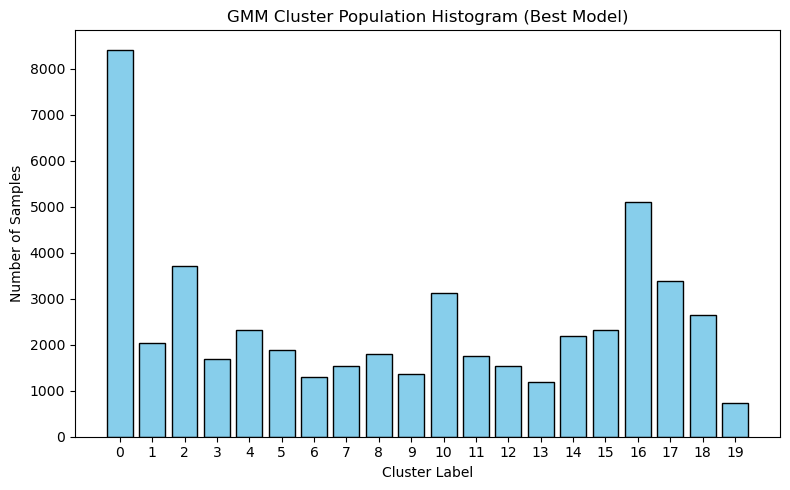

In [ ]:
# Filter valid models
valid_models = [r for r in gmm_results if r['silhouette'] > -0.035 and np.isfinite(r['dbi'])]

# Ranking system: low DBI, high Silhouette, low BIC
for r in valid_models:
    r['sil_rank'] = -r['silhouette']
    r['db_rank'] = r['dbi']
    r['bic_rank'] = r['bic']

# Normalise + Rank
sorted_models = sorted(valid_models, key=lambda r: r['sil_rank'] + 1.2*r['db_rank'] +  r['bic_rank'])  # 0.5 weight for complexity
best_model = sorted_models[0]
print(f"✅ Best GMM: k={best_model['k']}, cov={best_model['cov']}, silhouette={best_model['silhouette']:.3f}, DBI={best_model['dbi']:.3f}, BIC={best_model['bic']:.1f}")

# ---------------------- Final Fit & Visualisation ---------------------- #

final_gmm = best_model['model']
final_labels = final_gmm.predict(defect_latent_s[0:50000])

# Plot cluster histogram
unique_labels, counts = np.unique(final_labels, return_counts=True)

plt.figure(figsize=(8, 5))
plt.bar([str(lbl) for lbl in unique_labels], counts, color='skyblue', edgecolor='black')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Samples')
plt.title('GMM Cluster Population Histogram (Best Model)')
plt.tight_layout()
plt.show()

In [ ]:
#Best GMM: k=20, cov=full, silhouette=-0.035, DBI=3.254, BIC=-1494921.3
#gmm = best_model['model']
gmm = GaussianMixture(n_components=20, covariance_type='full', random_state=42)
gmmlabels = gmm.fit_predict(defect_latent_s)

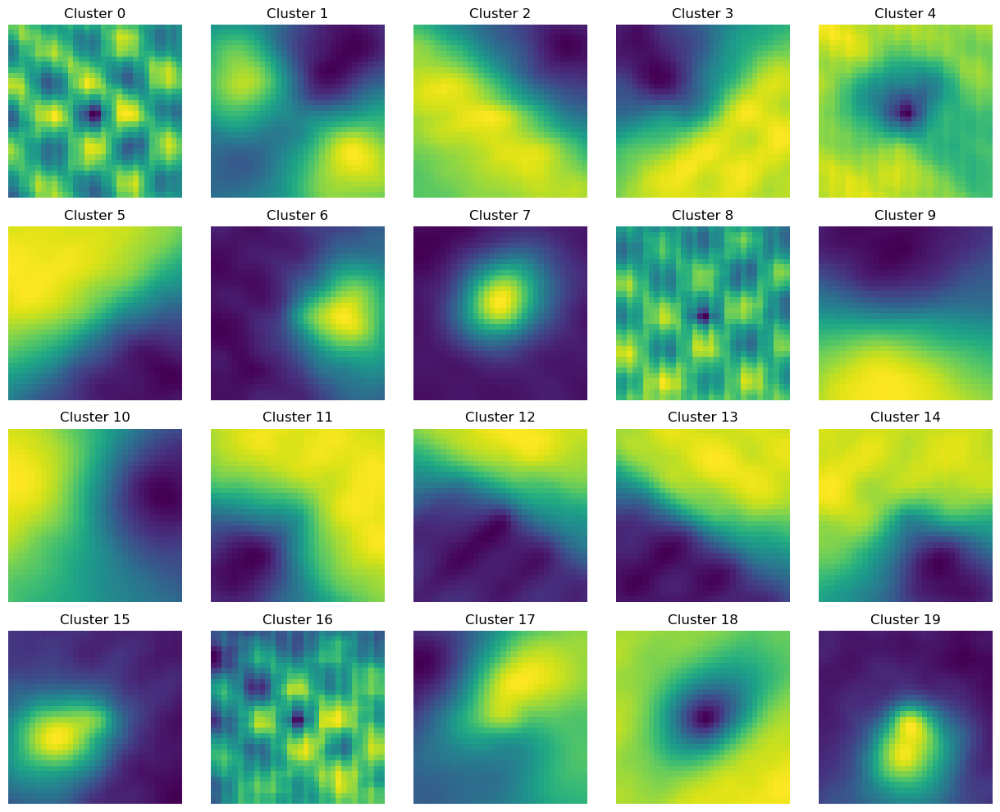

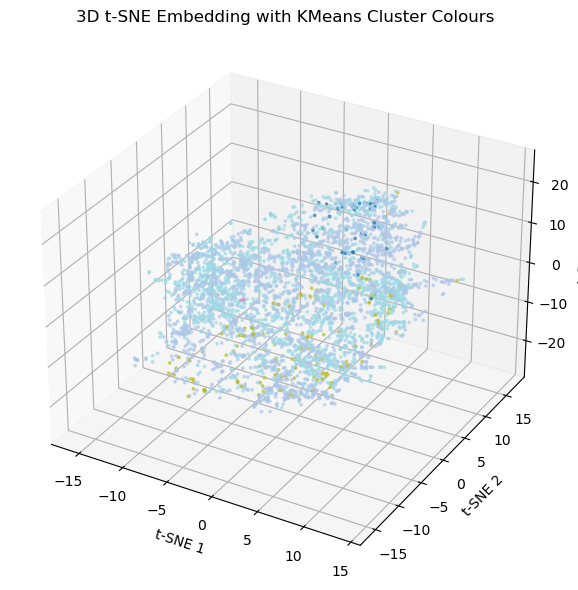

In [ ]:
def plot_cluster_averages(patches, cluster_labels, n_clusters=None):
    if n_clusters is None:
        n_clusters = len(np.unique(cluster_labels))

    # Compute mean patch per cluster
    avg_patches = []
    for k in range(n_clusters):
        cluster_patches = patches[cluster_labels == k]
        if cluster_patches.size == 0:
            print(f"Warning: Cluster {k} is empty.")
            avg_patch = np.zeros((32, 32))
        else:
            avg_patch = cluster_patches.mean(axis=0)
            avg_patches.append(avg_patch)

    # Plot the mean patches in a grid
    cols = min(n_clusters, 5)
    rows = int(np.ceil(n_clusters / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2.5, rows * 2.5))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < n_clusters:
            im = ax.imshow(avg_patches[i], cmap='viridis')
            ax.set_title(f'Cluster {i}')
            ax.axis('off')
        else:
            ax.axis('off')

    plt.tight_layout()
    plt.show()

plot_cluster_averages(patches=defect_sample, cluster_labels=gmmlabels)

n_points=4000
tsne = TSNE(n_components=3, perplexity=30, n_iter=1500, init='random', random_state=42)
embedded = tsne.fit_transform(defect_latent_s[0:n_points])

# 3D Plot
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(embedded[:, 0], embedded[:, 1], embedded[:, 2], c=final_labels[0:n_points], s=3, alpha=0.6, cmap='tab20')

ax.set_title('3D t-SNE Embedding with KMeans Cluster Colours')
ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
ax.set_zlabel('t-SNE 3')

plt.tight_layout()
plt.show()

## Full working model

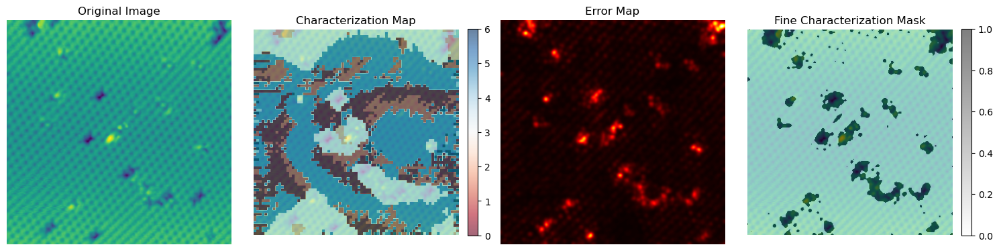

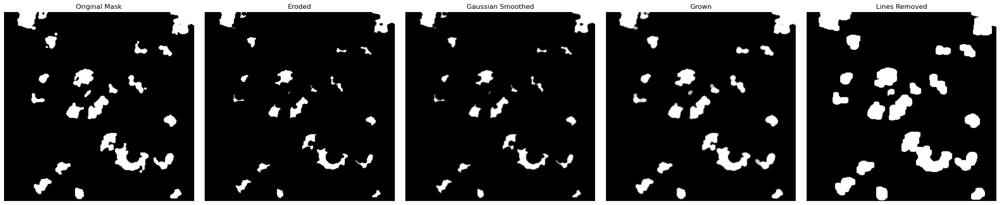

Number of regions detected: 20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


c:\Users\jaydi\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


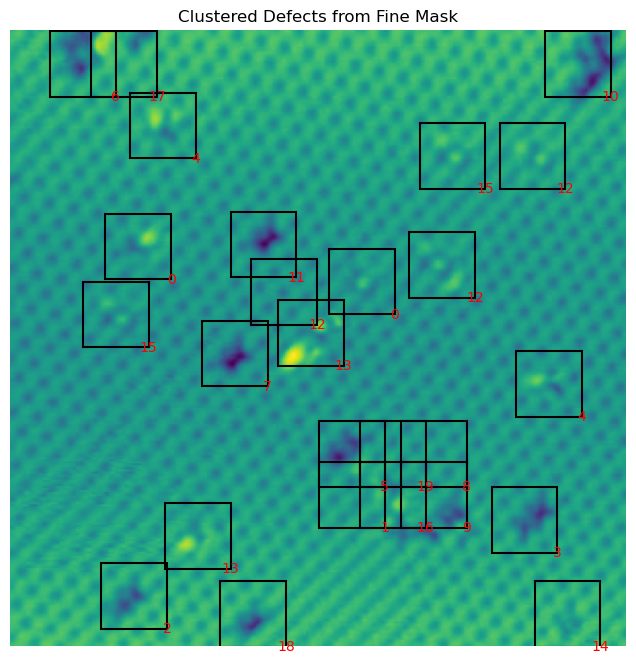

Plotting


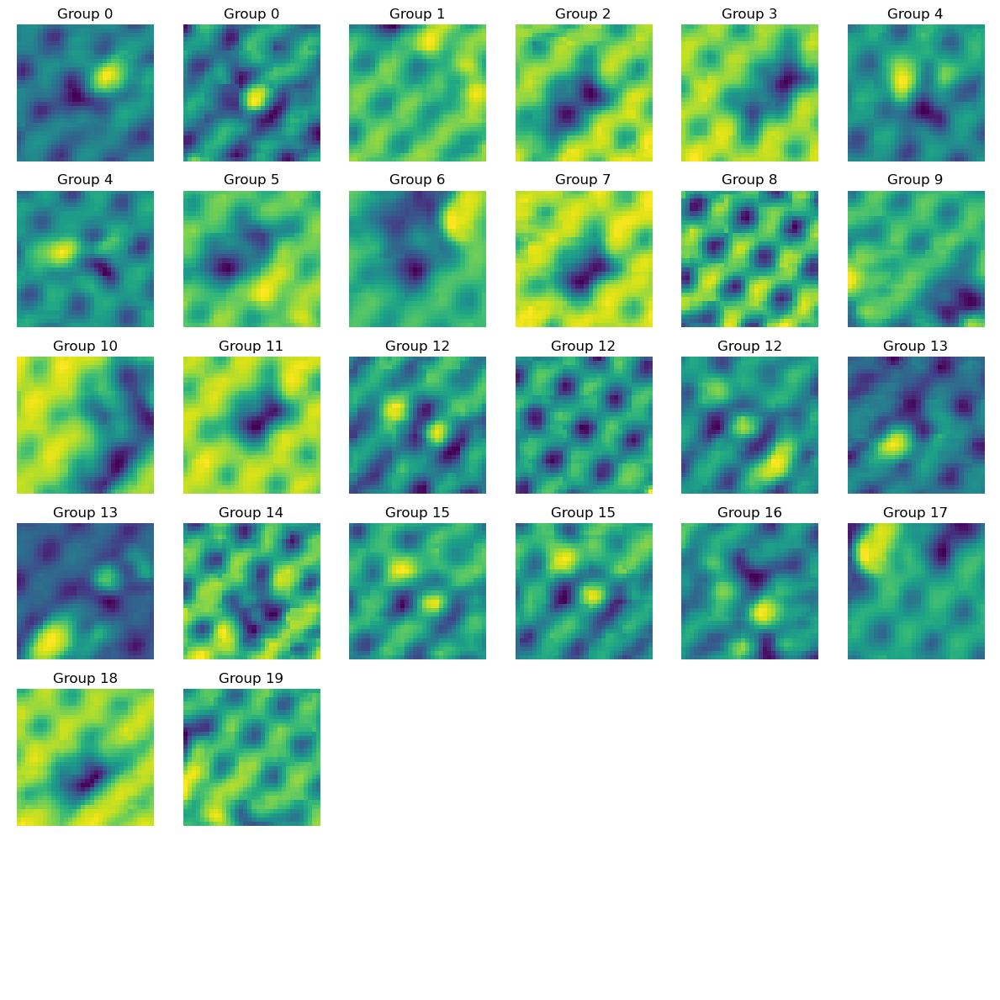

In [ ]:
char_map = mode_image(image, encoder_split, kmeansall, scaler, stride=4)
interactive_compareimage(image, char_map)

fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=1,
    kernel_size=5,
    line_threshold=3,
    sigma=0.5)

cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, def_encoder_split, gmm, defect_scaler, min_dist=20, plot_overlay=True, plot_defects=True)

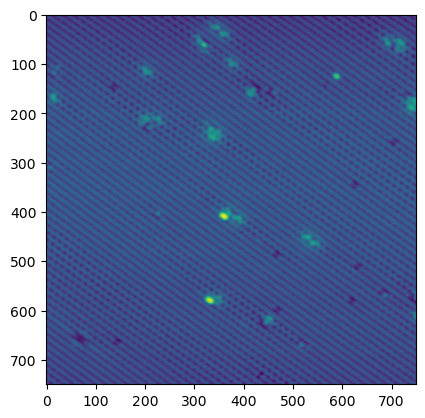

In [229]:
# image 17 doesn't work
# image 27 has large steps so lots of erroneuous points
image = (data[(data['Type'] == 'Predict')].iloc[29]['Image'])
plt.imshow(image)

In [230]:
char_map = mode_image(image, encoder_split, kmeansall, scaler, stride=4)
interactive_compareimage(image, char_map)

100%|██████████| 32400/32400 [09:06<00:00, 59.25it/s]


interactive(children=(Dropdown(description='selected_group', options=(None, 0, 1, 2, 3, 4, 5, 6), value=None),…

100%|██████████| 32/32 [01:14<00:00,  2.33s/it]


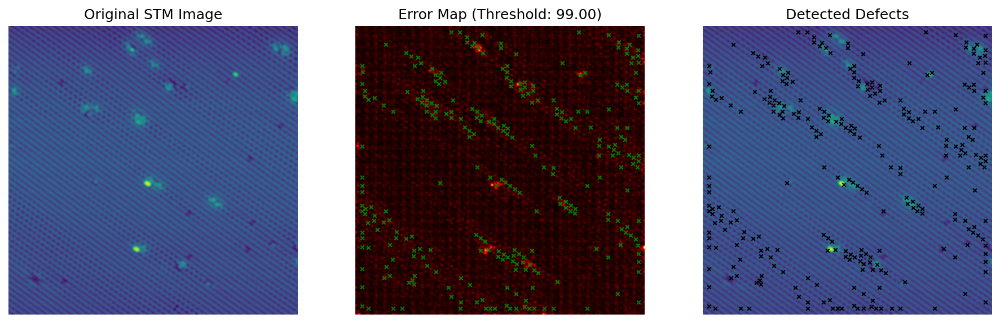

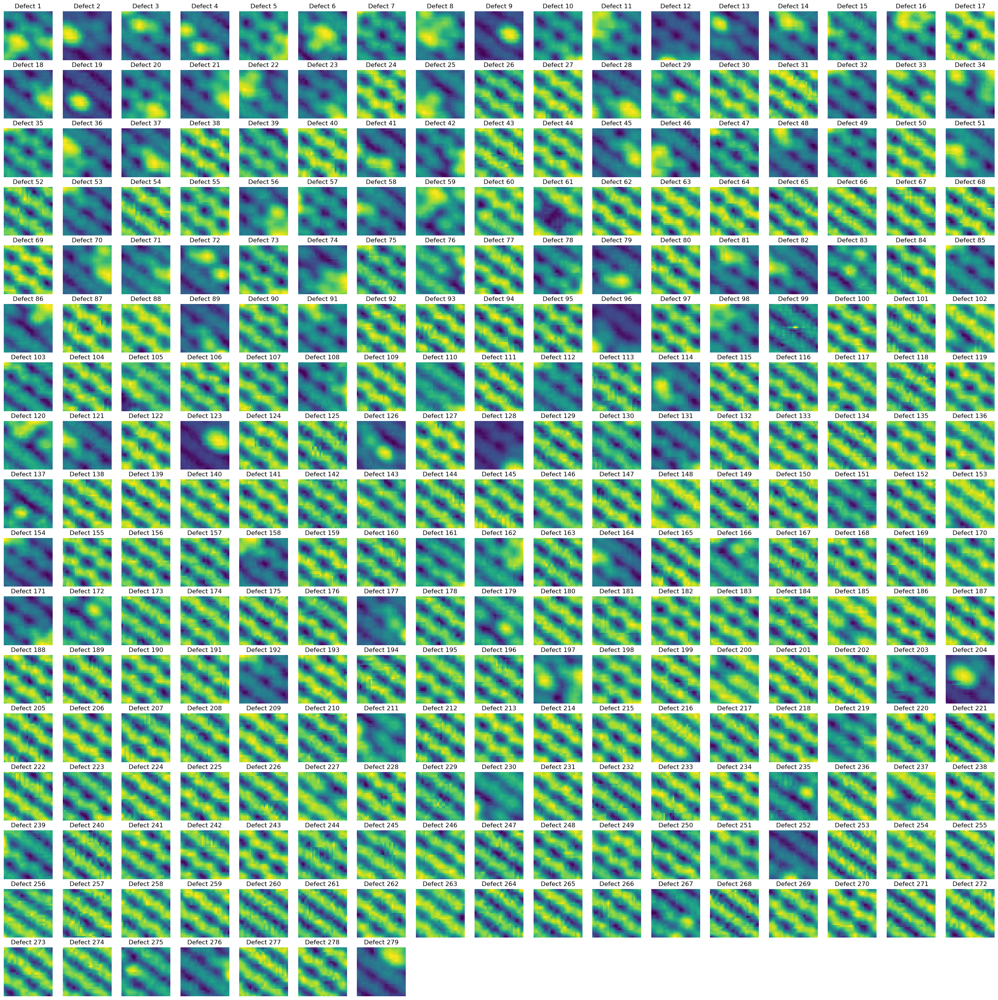

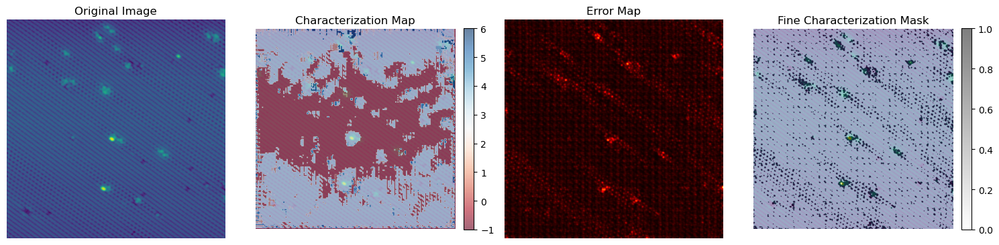

In [ ]:
error_map, defect_patches, defect_centers = extract_high_error_patches(image, model, stride=24, plot_maps=True, plot_defects=True)
fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

High-error threshold: 0.0017, pixels above threshold: 56250
Target cluster match pixels: 559504
Final fine mask nonzero pixels: 55206


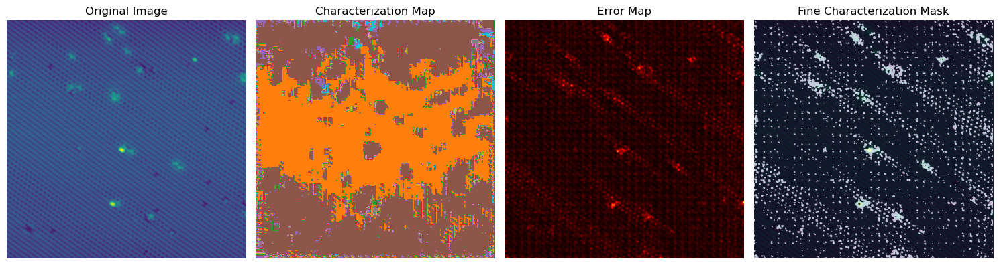

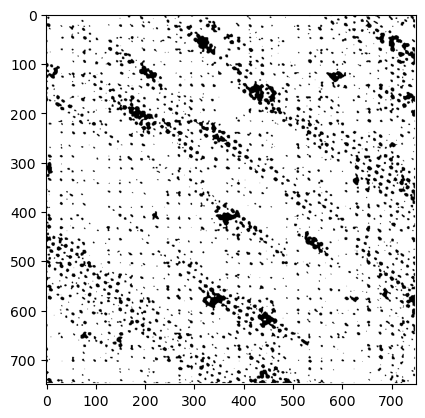

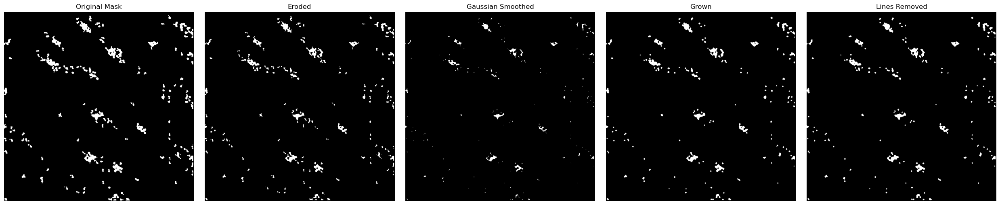

Number of regions detected: 96
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


c:\Users\jaydi\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


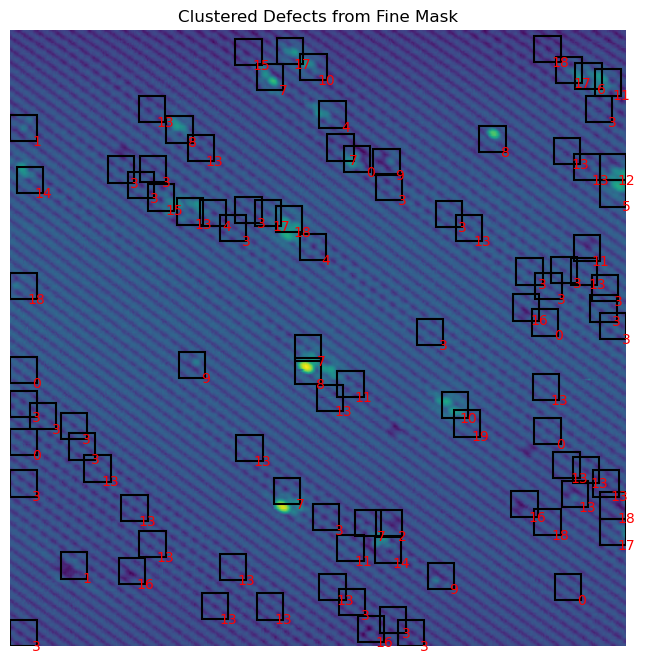

Plotting


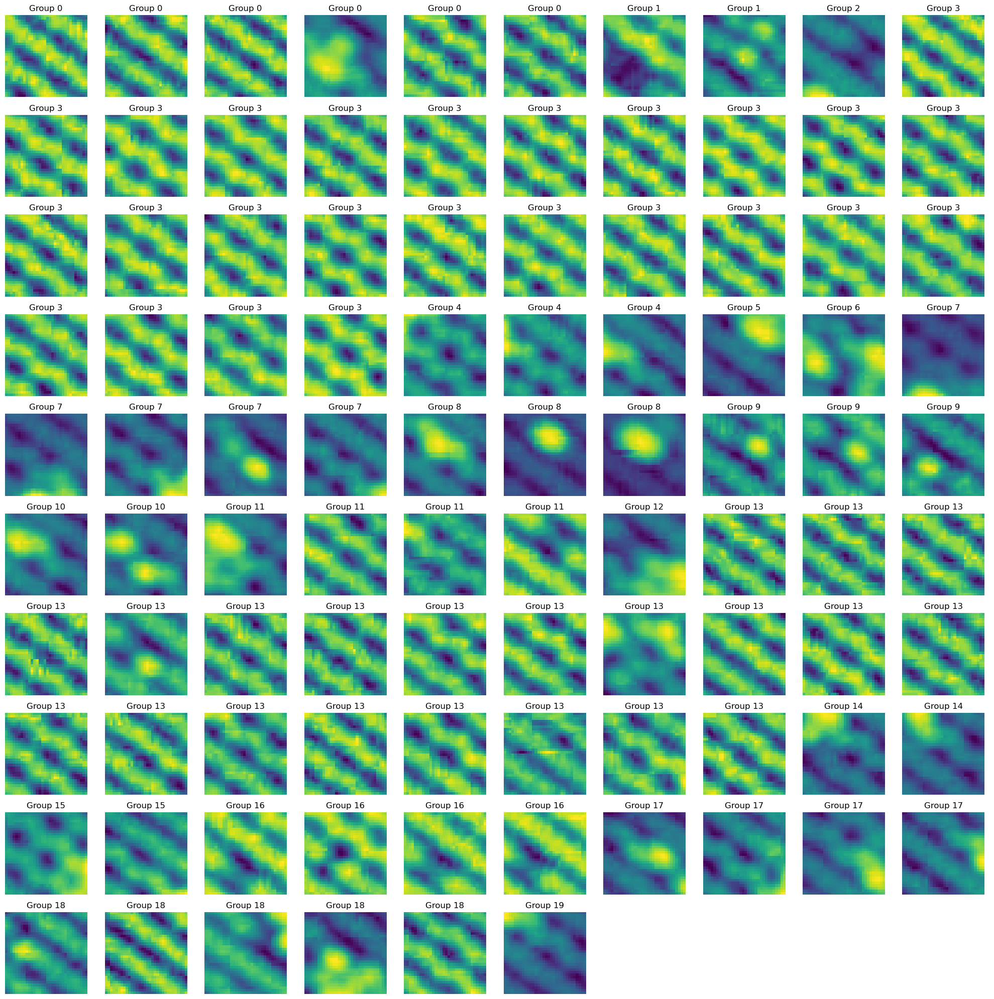

In [ ]:
fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

plt.imshow(fine_map, cmap='binary')
plt.show()
cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=2,
    kernel_size=3,
    line_threshold=3,
    sigma=1)

cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, def_encoder_split, gmm, defect_scaler, min_dist=24, plot_overlay=True, plot_defects=True)

100%|██████████| 129600/129600 [40:40<00:00, 53.11it/s] 


(-0.5, 749.5, 749.5, -0.5)

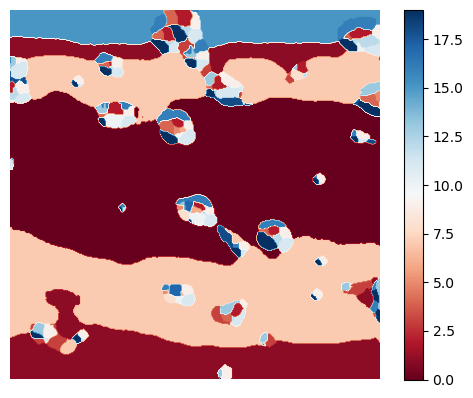

In [ ]:
#char_map = mode_image(image, def_encoder_split, gmm, defscaler, stride=2)
plt.imshow(char_map, cmap='RdBu')
plt.colorbar()
plt.axis('off')

## Really GOOD example

100%|██████████| 11881/11881 [03:57<00:00, 49.95it/s]


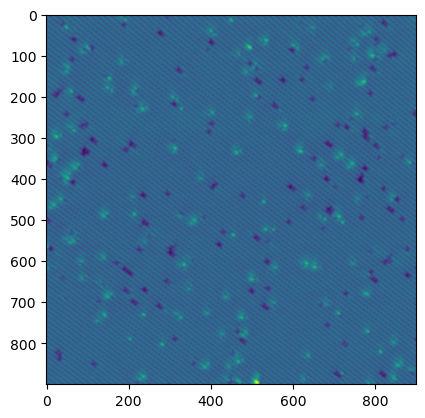

interactive(children=(Dropdown(description='selected_group', options=(None, 0, 1, 2, 3, 4, 5, 6), value=None),…

In [19]:
filepath = 'MSc2024_Data\jpg\predict\default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FU.jpg'  # Replace with your actual path
image = Image.open(filepath)
image = np.array(image)
image = image[:,:,0]/255.0
plt.imshow(image, cmap='viridis')

char_map = mode_image(image, encoder_split, kmeansall, scaler, stride=8)
interactive_compareimage(image, char_map)

100%|██████████| 29/29 [01:16<00:00,  2.64s/it]


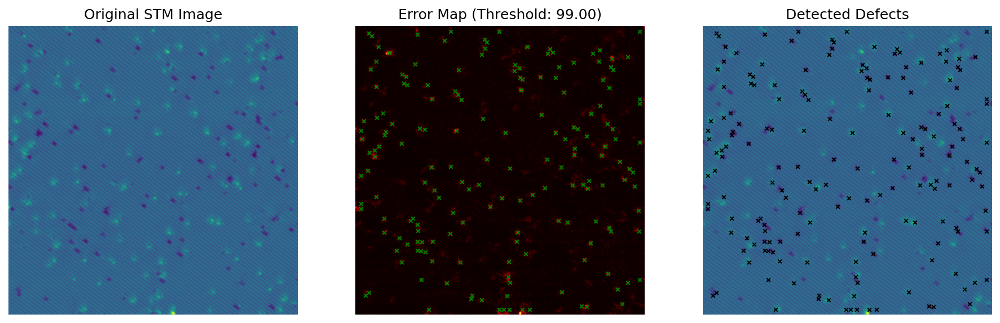

High-error threshold: 0.0006, pixels above threshold: 81000
Target cluster match pixels: 802816
Final fine mask nonzero pixels: 79764


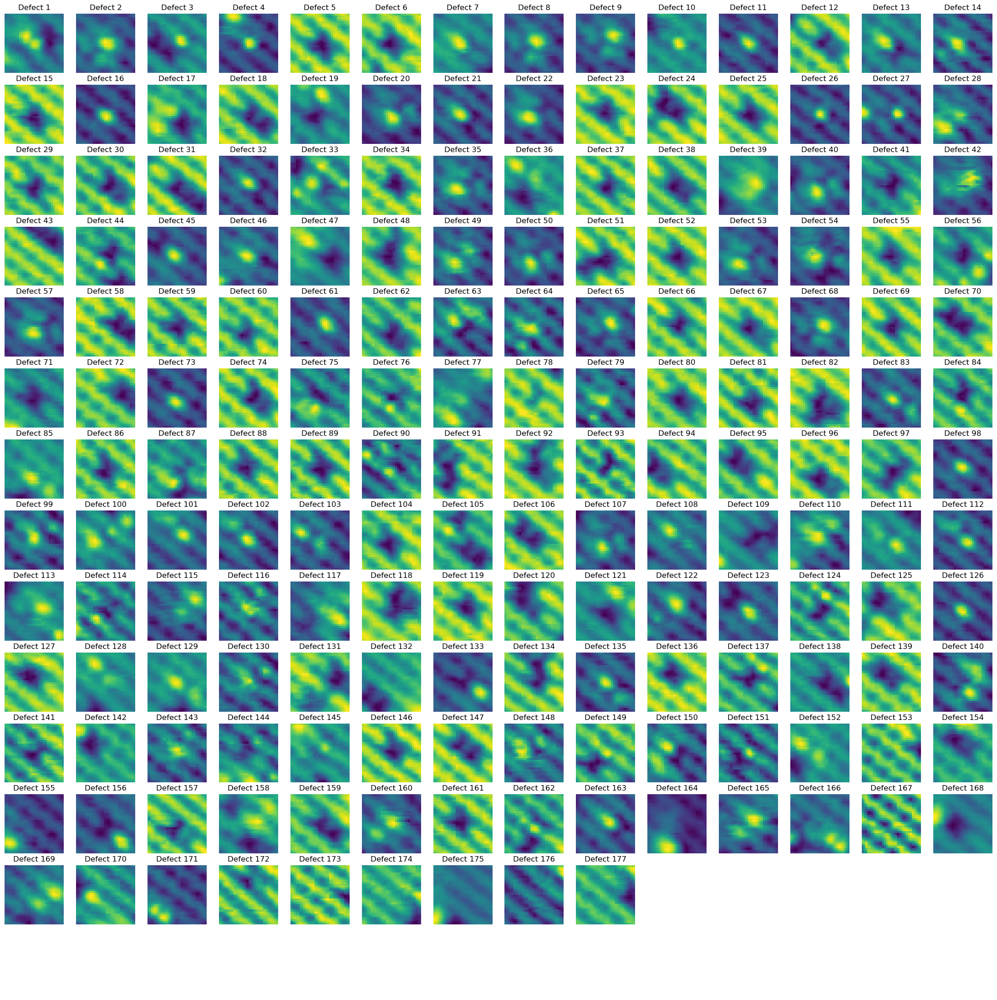

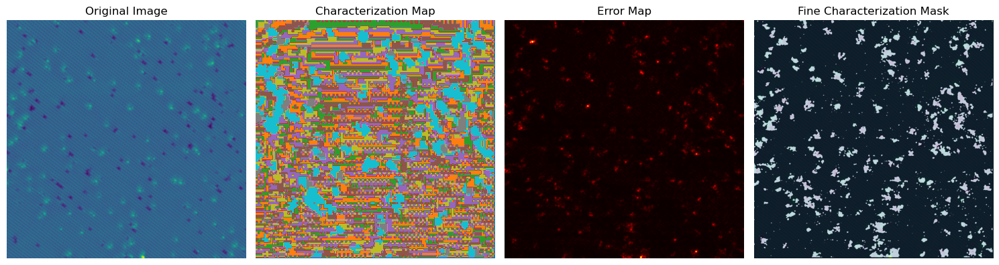

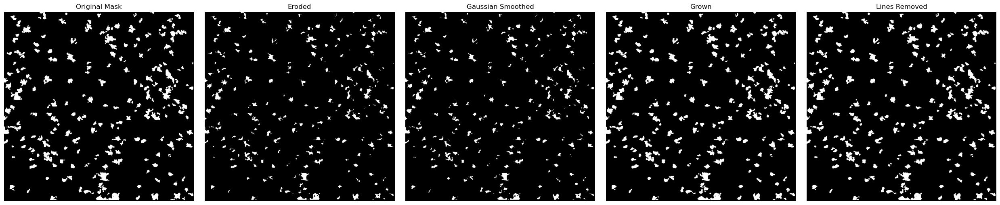

Number of regions detected: 240
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


c:\Users\jaydi\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


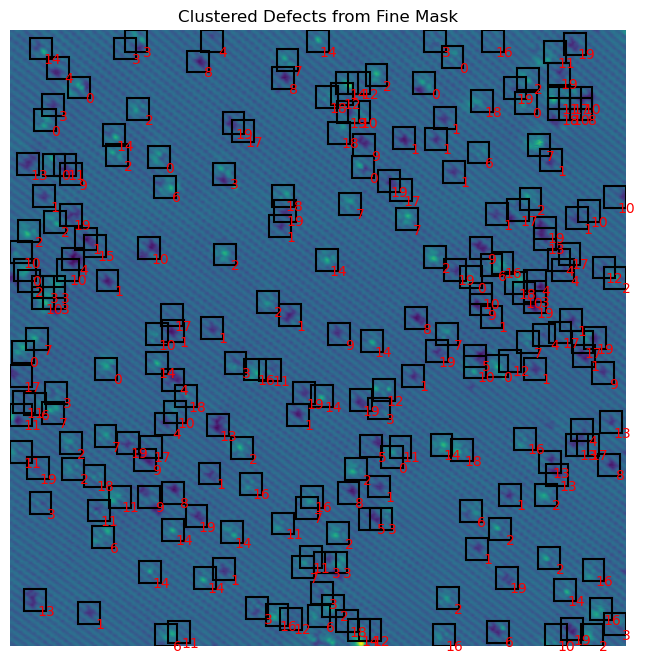

Plotting


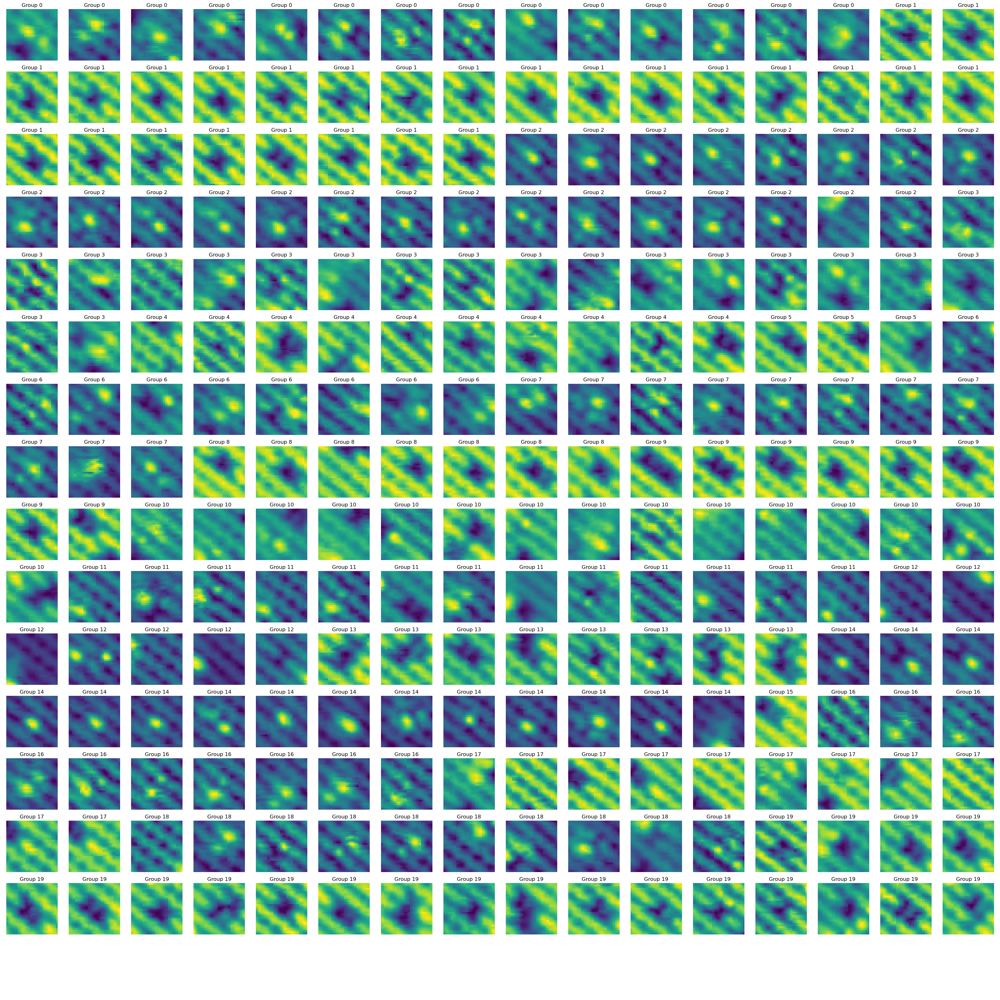

In [ ]:
error_map, defect_patches, defect_centers = extract_high_error_patches(image, model, stride=32, min_dist=10, plot_maps=True, plot_defects=True)

fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=1,
    kernel_size=5,
    line_threshold=3,
    sigma=0.1)

cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, def_encoder_split, gmm, defect_scaler, min_dist=16, plot_overlay=True, plot_defects=True)

## Bad/limited applications

100%|██████████| 5184/5184 [02:43<00:00, 31.67it/s]


interactive(children=(Dropdown(description='selected_group', options=(None, 0, 1, 2, 3, 4, 5, 6), value=None),…

100%|██████████| 25/25 [01:34<00:00,  3.79s/it]


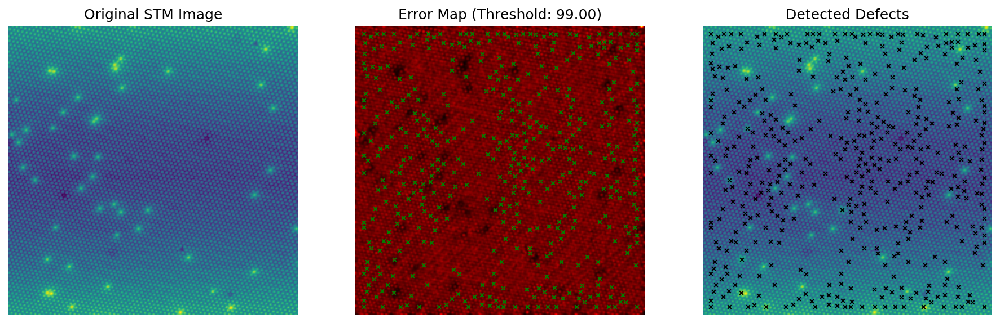

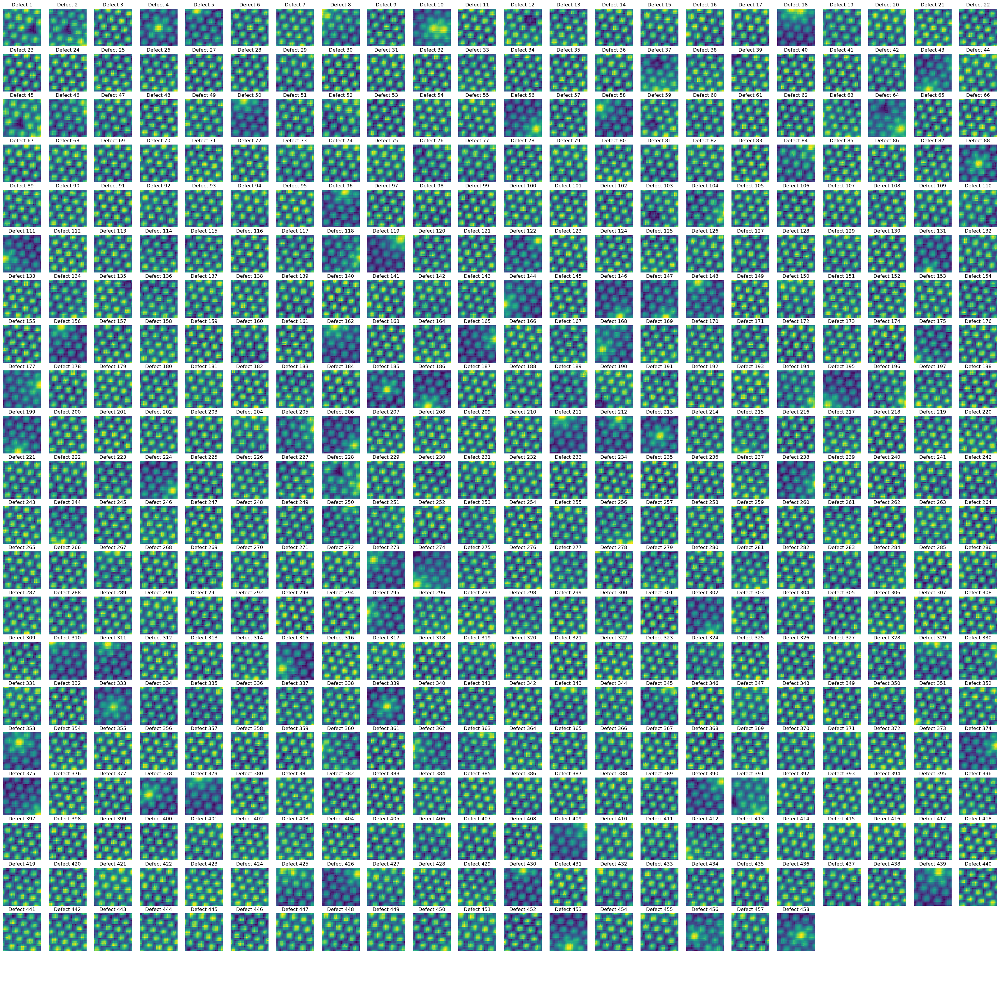

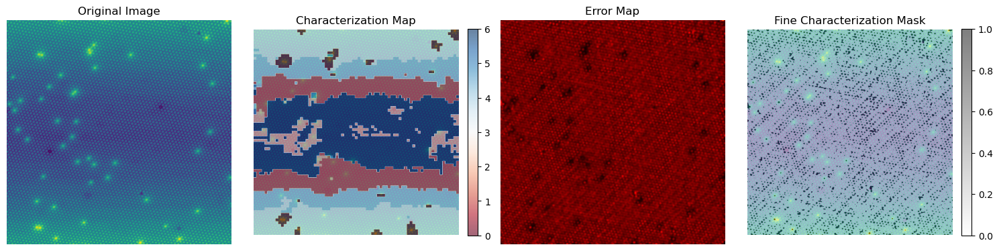

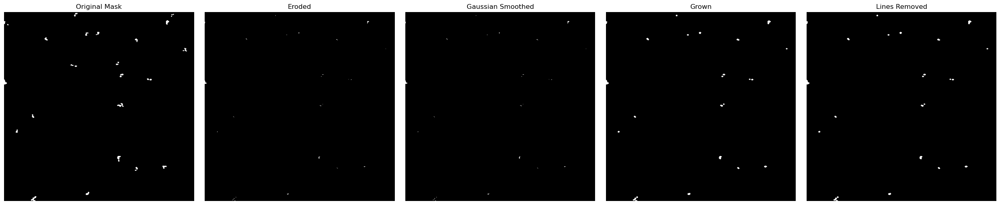

Number of regions detected: 24
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


c:\Users\jaydi\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


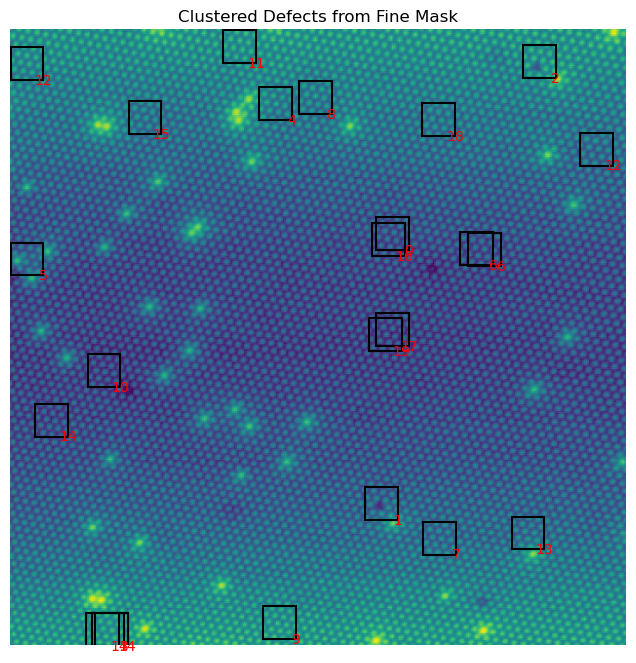

Plotting


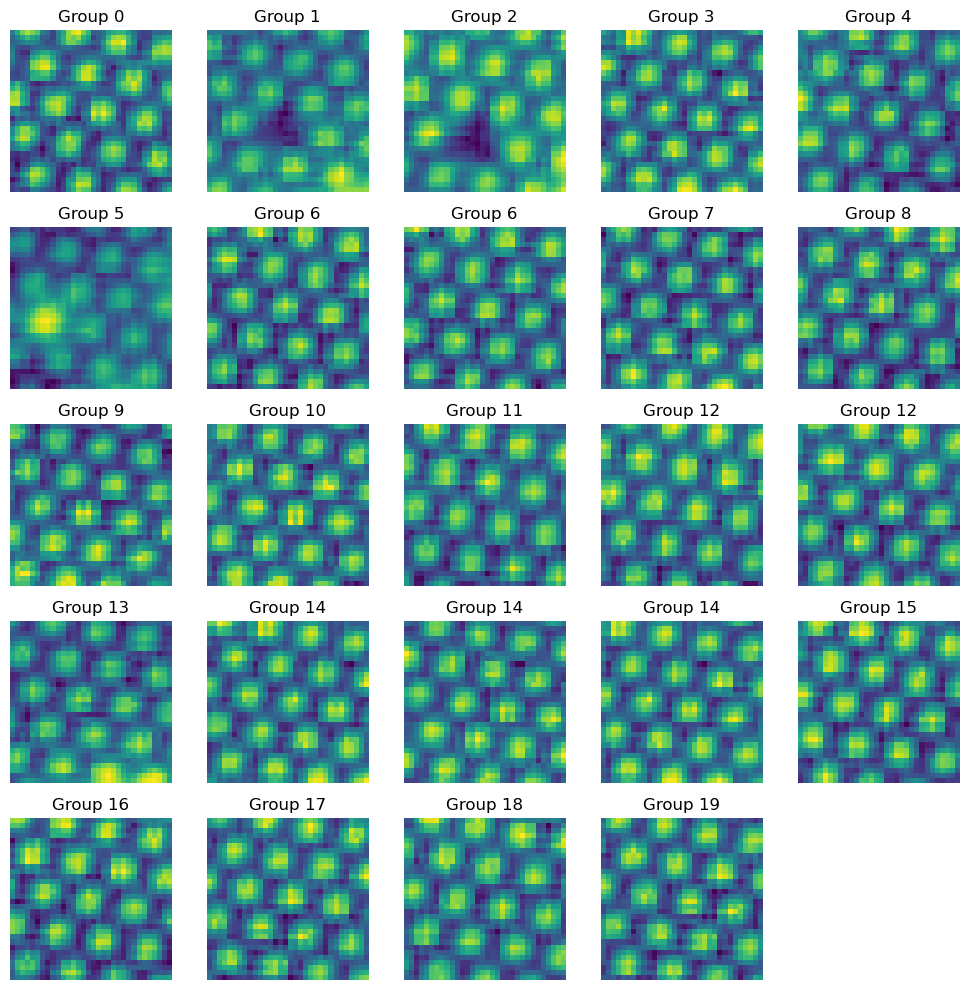

100%|██████████| 8100/8100 [05:04<00:00, 26.60it/s]


interactive(children=(Dropdown(description='selected_group', options=(None, 0, 1, 2, 3, 4, 5, 6), value=None),…

100%|██████████| 32/32 [02:36<00:00,  4.89s/it]


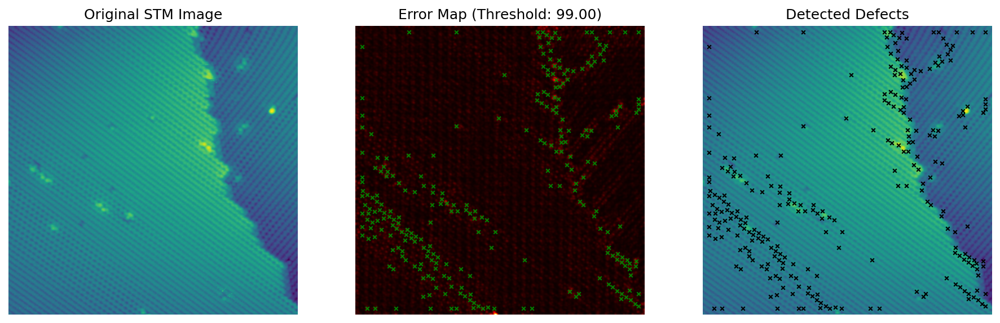

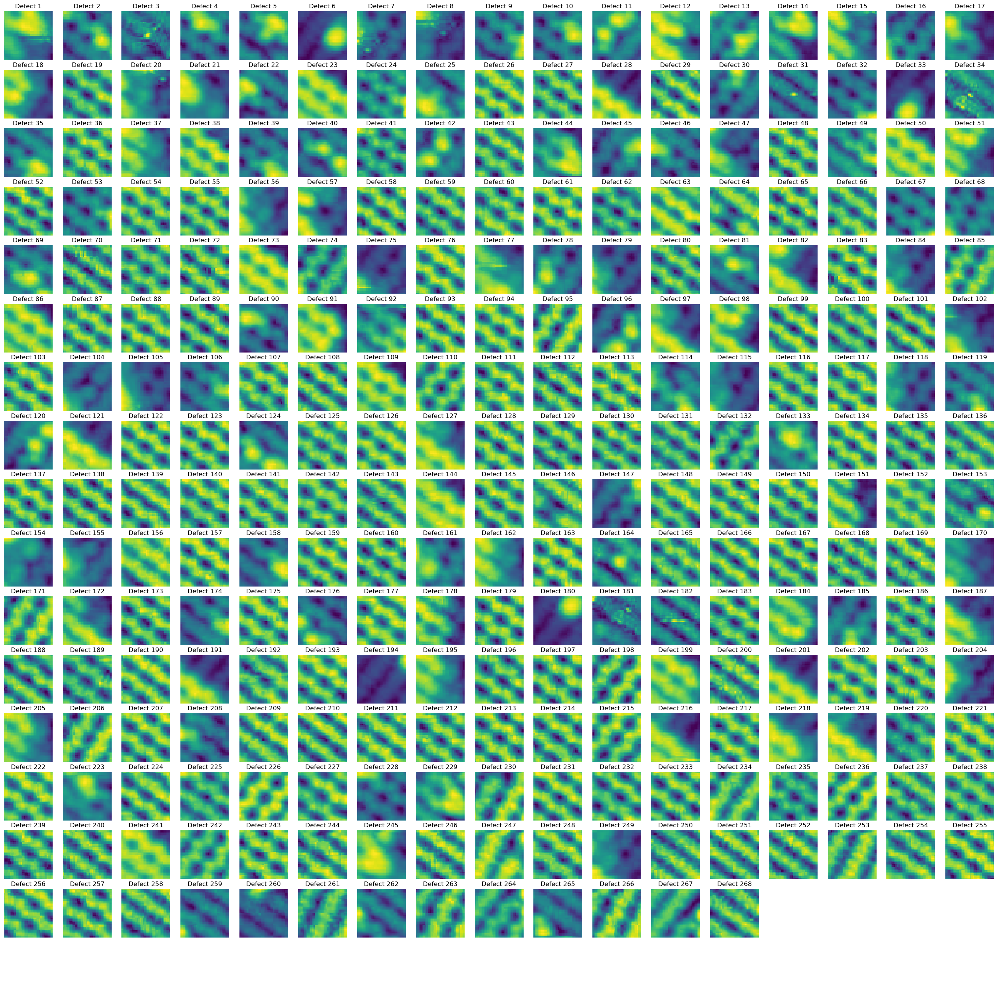

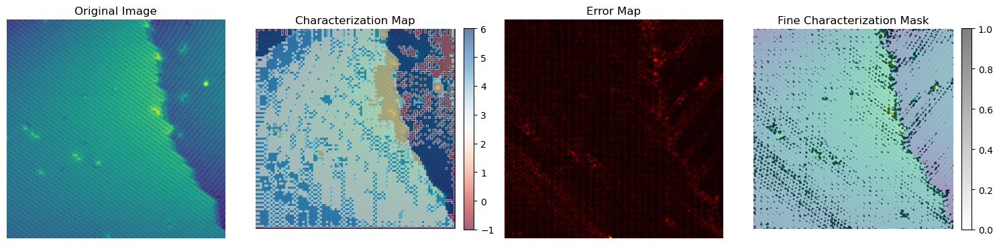

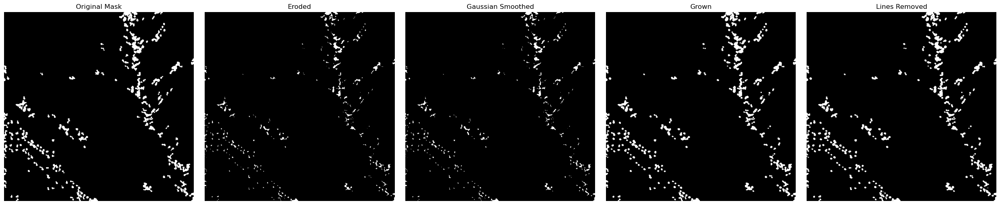

Number of regions detected: 227
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step


c:\Users\jaydi\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


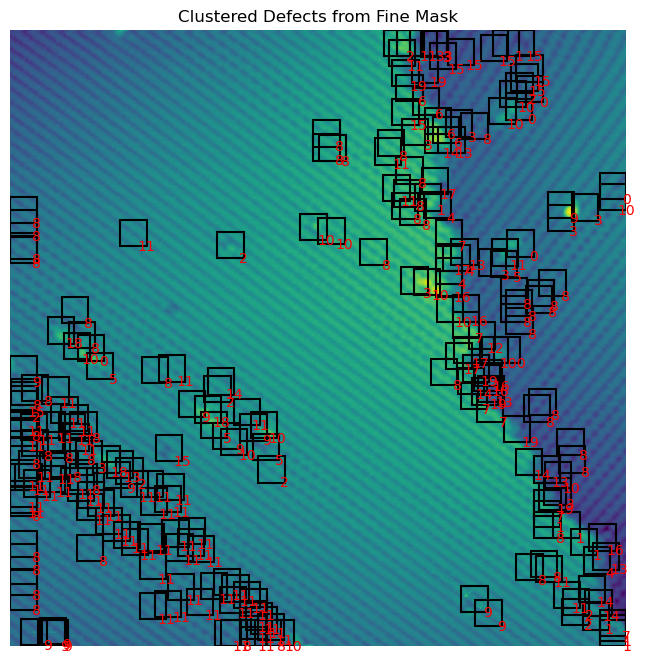

Plotting


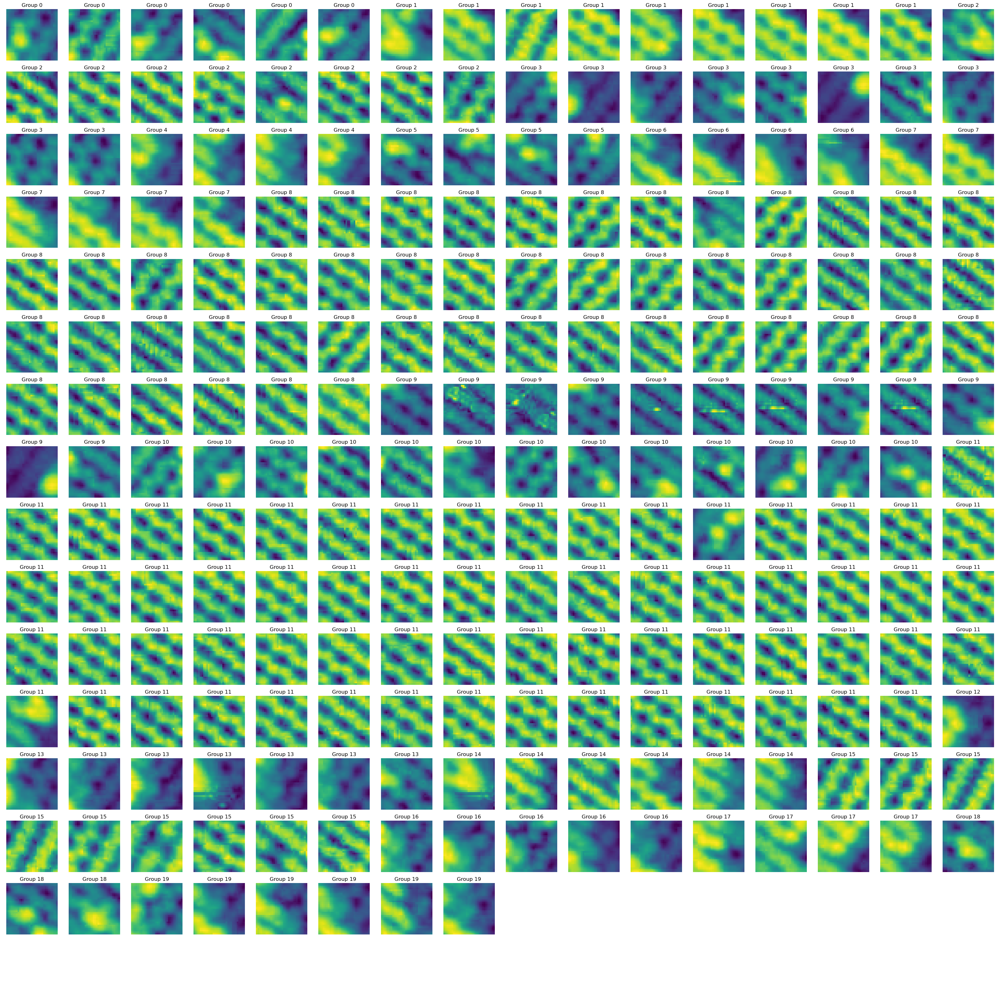

In [ ]:
image = (data[(data['Type'] == 'Predict')].iloc[17]['Image'])
# image 17 doesn't work
# image 27 has large steps so lots of erroneuous points
char_map = mode_image(image, encoder_split, kmeansall, scaler, stride=8)
interactive_compareimage(image, char_map)
error_map, defect_patches, defect_centers = extract_high_error_patches(image, model, stride=24, plot_maps=True, plot_defects=True)
fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=1,
    kernel_size=5,
    line_threshold=3,
    sigma=0.1)

cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, def_encoder_split, gmm, defect_scaler, min_dist=16, plot_overlay=True, plot_defects=True)

image = (data[(data['Type'] == 'Predict')].iloc[27]['Image'])
# image 17 doesn't work
# image 27 has large steps so lots of erroneuous points
char_map = mode_image(image, encoder_split, kmeansall, scaler, stride=8)
interactive_compareimage(image, char_map)
error_map, defect_patches, defect_centers = extract_high_error_patches(image, model, stride=24, plot_maps=True, plot_defects=True)
fine_map = generate_fine_characterization_mask(image, char_map, error_map, defect_centers, plot_mask=True, error_percentile=90)

cleaned_mask = clean_defect_mask(fine_map, min_area=60)

eroded_mask = clean_and_round_blobs(
    cleaned_mask,
    shrink_iterations=1,
    grow_iterations=1,
    kernel_size=5,
    line_threshold=3,
    sigma=0.1)

cluster_labels, filtered_patches, filtered_centers = extract_masked_patches_and_cluster(
    image, eroded_mask, def_encoder_split, gmm, defect_scaler, min_dist=16, plot_overlay=True, plot_defects=True)
    